# Estimación por Kriging (UG 3)

Nuestro **objetivo** es estimar el contenido del commodity de interés utilizando solo aquellas muestras pertenecientes a una misma población (UG) en el volumen espacial.

De momento, **no sera posible limitar la estimación dentro del limite definido** para cada una de las Unidades Geológicas en la sección anterior, y esto quedará para la sección siguiente como post-proceso una vez finalizada la estimación en cada UG.

Se entrega aca el flujo de trabajo a modo de ejemplo **sólo** para una unidad geológica (UG 3). **Usted y su grupo debe replicar el procedimiento para el resto de las unidades.**



## Cargar las bibliotecas requeridas

El siguiente código carga las bibliotecas requeridas y crea algunas carpetas que nos ayudan a mantener cierto orden.

In [1]:
import numpy as np                                            # ndarrays for gridded data
import pandas as pd                                           # DataFrames for tabular data

import geostatspy.GSLIB as GSLIB                              # GSLIB utilities, visualization and wrapper
import geostatspy.geostats as geostats                        # GSLIB methods convert to Python      
import geostatspy
print('GeostatsPy version: ' + str(geostatspy.__version__))  

import os                                                     # set working directory, run executables

from tqdm import tqdm                                         # suppress the status bar
from functools import partialmethod
tqdm.__init__ = partialmethod(tqdm.__init__, disable=True)

ignore_warnings = True                                        # ignore warnings?

import matplotlib.pyplot as plt                               # for plotting
import matplotlib as mpl                                      # custom colorbar
import matplotlib.ticker as mticker                           # custom colorpar ticks
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator) # control of axes ticks
plt.rc('axes', axisbelow=True)                                # plot all grids below the plot elements
if ignore_warnings == True:                                   
    import warnings
    warnings.filterwarnings('ignore')

import os
import matplotlib.image as mpimg
import subprocess
import time
from matplotlib.offsetbox import AnchoredText
import matplotlib.gridspec as gridspec

import plotly.io as pio
import plotly.graph_objects as go
import plotly.express as px
import plotly.offline as py

# trimmed inverted rainbow colormap hsv removing magenta tones
cmap = mpl.colors.ListedColormap(mpl.cm.hsv(np.linspace(0.0, 0.70, 256))).reversed()

# Crear carpetas 01_data, 02_parametros, 03_resultados si no existen
if not os.path.exists('./01_data'):
    os.makedirs('./01_data')
if not os.path.exists('./02_parametros'):
    os.makedirs('./02_parametros')
if not os.path.exists('./03_resultados'):
    os.makedirs('./03_resultados')


GeostatsPy version: 0.0.78


Nuestro punto de partida sera la base de datos simplificada de la sección anterior. Filtramos aquellas muestras que pertenezcan a nuestra UG de interés. Luego exportamos la base de datos en formato GSLIB para ser procesada por la libreria. **La exportación no debe contener ningún caracter y solo debe contener números**, sino no podrá ser procesado.

In [2]:
## Cargar data simplificada de la sección anterior

import pandas as pd
import numpy as np

# Cargar base de datos en pandas y aproximar a dos decimales
df = pd.read_csv('data.csv', sep=',', encoding='latin1').round(2)
df['UG'] = df['UG'].astype(int)  # Asegurarse de que la columna 'UG' sea de tipo entero

# Filtrar data para quedarnos solo con UG 3
df = df[df['UG'] == 3].reset_index(drop=True)

# Guardar data en formato GSLIB
GSLIB.Dataframe2GSLIB('./01_data/data_UG3.dat',df)  # guardar data

df.head()  # mostrar las primeras filas de la data

,X,Y,Z,cu_pct,UG
0,472203.46,6925833.67,4010.36,0.30,3
1,472203.97,6925834.42,4004.43,0.37,3
2,472204.47,6925835.16,3998.50,0.35,3
3,471609.64,6925379.97,4368.24,0.01,3
4,471610.96,6925382.94,4363.20,0.04,3


In [3]:
# Chequeamos algunas estadísticas básicas de la muestras
df['cu_pct'].describe()

count    2048.000000
mean        0.132529
std         0.128619
min         0.000000
25%         0.040000
50%         0.090000
75%         0.190000
max         1.640000
Name: cu_pct, dtype: float64

## Búsqueda de anisotropías y variograma experimental

### Mapas Variográficos

Utilizamos los mapas variográfico para buscar anisotropías. A continuacion se explican los parametros requeridos para correr el programam ```VARMAP``` de la GSLIB.

* **file with data**: archivo con los datos de sondajes.
* **number of variables: column numbers**: primer numero es el nº de
variables a analizar (será 1 pues solo tenemos la ley). Segundo nº indica la columna en el archivo data.dat donde se ubica la variable.
* **trimming limits**: se indica el rango de valores de la variable que
usaremos para hacer el análisis (se usará de preferencia de 0 a infinito).
* **1=regular grid, 0=scattered values**: Nos pregunta si los sondajes
están en grilla regular ( 1) o dispersos (0).
* **if =1: nx, ny, nz**: Esta línea se edita solo cuando en la línea
anterior se coloca 1, en nuestro caso se deja tal cual.
*** xsiz, ysiz, zsiz**: Esta línea se edita solo cuando en la línea
anterior se coloca 1, en nuestro caso se deja tal cual.
* **if =0: columns for x,y, z coordinates**:Se ingresa la columna para la
coordenada x,y,z en el archivo de entrada ( Puntosporfido.prn ).
* **file for variogram output**: Se pone el nombre del
archivo de salida de este ejecutable (debe tener extensión *.out).
* **nxlag, nylag, nzlag**: Se pone el nº de pasos que queremos que
tengan los variogramas del mapa variográfico. Se debe recordar que el nº de pasos (nxlag) multiplicado por el largo del paso en una coordenada (dxlag) debe ser igual (aprox) a la mitad de la extensión del dominio en esa coordenada. Por ejemplo, si nuestro deposito mide 2000 m. en coord. X, luego se harán 20 pasos de 50m lo cual es aprox la mitad del largo del dominio.
* **dxlag, dylag, dzlag**: Serán los largos de los pasos del mapa en las
diferentes direcciones.
* **minimum number of pairs**: Se coloca el mínimo nº de pares de datos
que queremos que el mapa requiera para realizar el cálculo en una dirección y
distancia (de preferencia se pone 1).
* **standardize sill? (0=no, 1=yes)**: Nos pregunta si queremos una
meseta. De preferencia se pone 0.
* **number of variograms**: Nos pide el número de variogramas a hacer,
será 1.
* **tail, head, variogram type**: Nos pide la cabeza y cola de los datos de variograma en los primeros 2 números, en el 3ro nos pide el tipo de variograma que aparece en la lista de abajo (se debe colocar 1 en todos los ítems)

In [45]:
nxlag=25; nylag=25; nzlag=25 ## Estos valores pueden ser ajustados para encontrar la mejor representación variográfica
dxlag=50; dylag=50; dzlag=50 ## Estos valores pueden ser ajustados para encontrar la mejor representación variográfica

## Definir archivo de parámetros para VARMAP

parfile = '''                  Parameters for VARMAP
                  *********************

START OF PARAMETERS:
./01_data/data_UG3.dat          -file with data
1   4                        -   number of variables: column numbers
0     999           -   trimming limits
0                            -1=regular grid, 0=scattered values
 50   50    1                -if =1: nx,     ny,   nz - No mover
1.0  1.0  1.0                -       xsiz, ysiz, zsiz  - No mover
1   2   3                    -if =0: columns for x,y, z coordinates
./03_resultados/varmap_UG3.out                   -file for variogram output
'''+str(nxlag)+" "+str(nylag)+" "+str(nzlag)+'''              -nxlag, nylag, nzlag
'''+str(dxlag)+" "+str(dylag)+" "+str(dzlag)+'''              -dxlag, dylag, dzlag
5                            -minimum number of pairs
0                            -standardize sill? (0=no, 1=yes)
1                            -number of variograms
1   1   1                    -tail, head, variogram type
'''

with open("02_parametros/varmap_UG3.par", "w") as f:
    f.write(parfile)

Todos los programas de la GSLIB requieren la definición de  un archivo de parámetros antes de ser ejecutados. Con este archivo de parámetros definido, podemos ejecutar el programa.

In [46]:
# Ejecutar vmodel de GSLIB
result = subprocess.run(["./Gslib90/varmap", "./02_parametros/varmap_UG3.par"], capture_output=True, text=True, check=True)

El resultado del mapa variográfico tendrá el doble de celdas indicadas en cada dirección ```2*nxlag+1, 2*nylag+1, 2*nzlag+1```

Usamos los parametros definidos anteriormente para leer la salida del programa ```VARMAP```, la cual sera una imagen variográfica en formato de grilla GSLIB.

```nxlag, nylag, nzlag```

```dxlag, dylag, dzlag```

In [47]:
## Leer resultado de varmap
varmap_UG3 = GSLIB.GSLIB2ndarray_3D("./03_resultados/varmap_UG3.out ", 0, 1, 2*nxlag+1, 2*nylag+1, 2*nzlag+1)[0][0]

Debido a que el mapa variografico es en realidad una funcion en tres dimensiones (un elipsodie tridimensional con valores), es necesario realizar cortes o secciones en este espacio para generar una imagen de valores variograficos. Definimos este corte en la mitad de cada uno de los ejes.

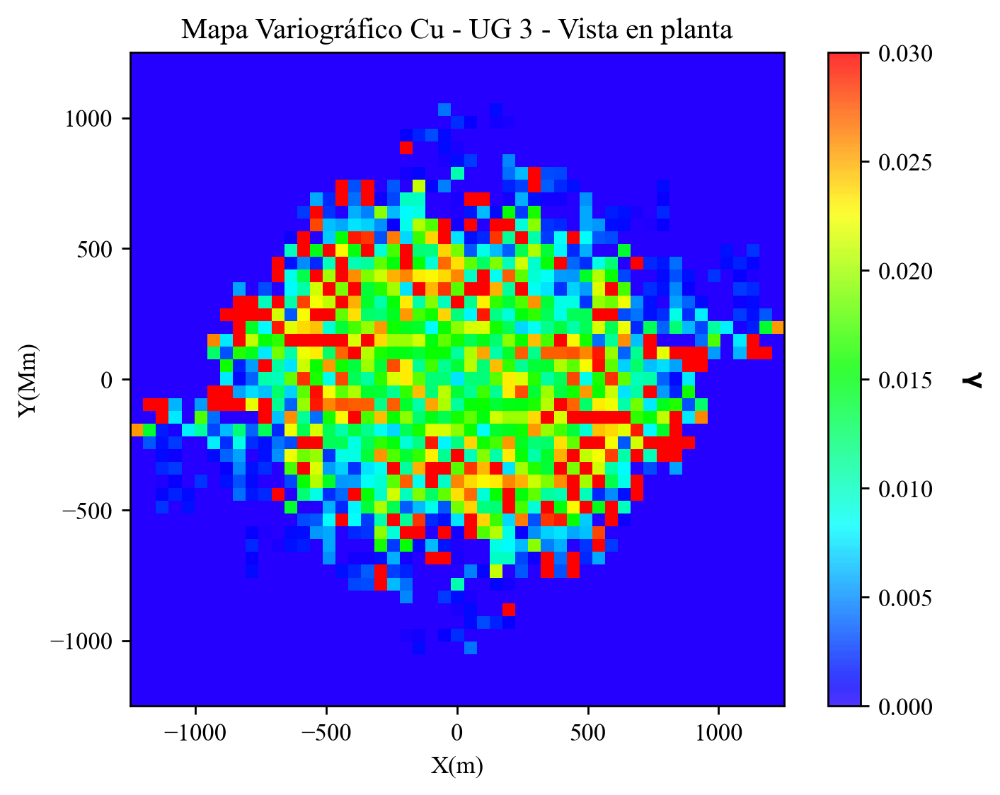

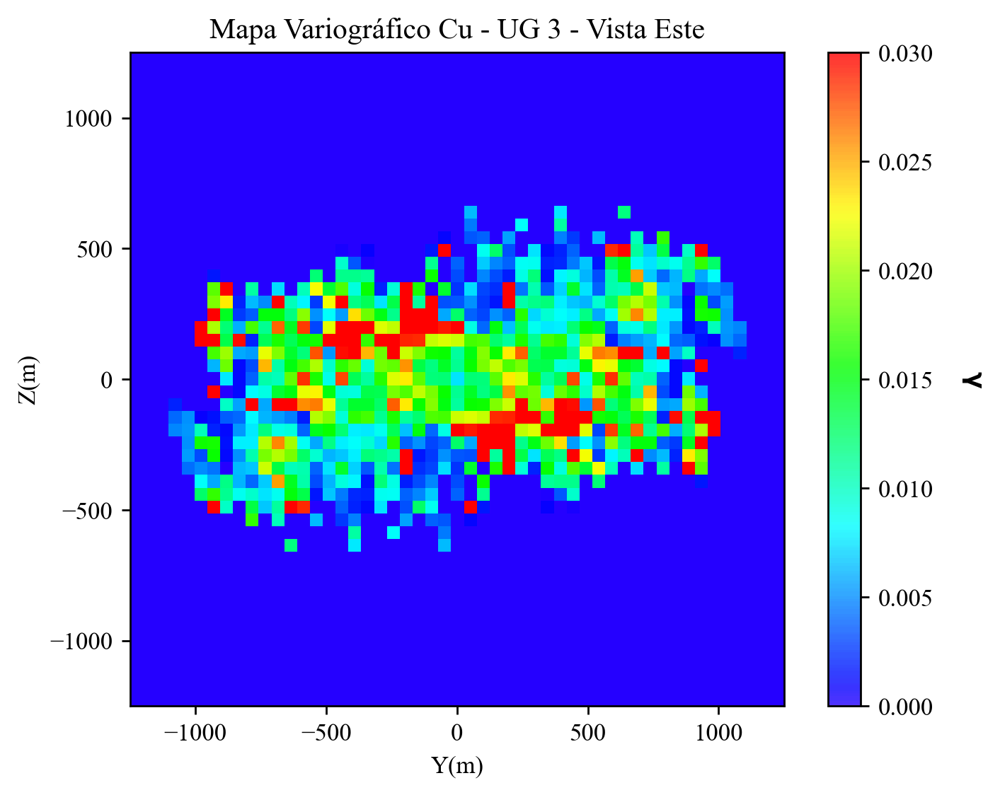

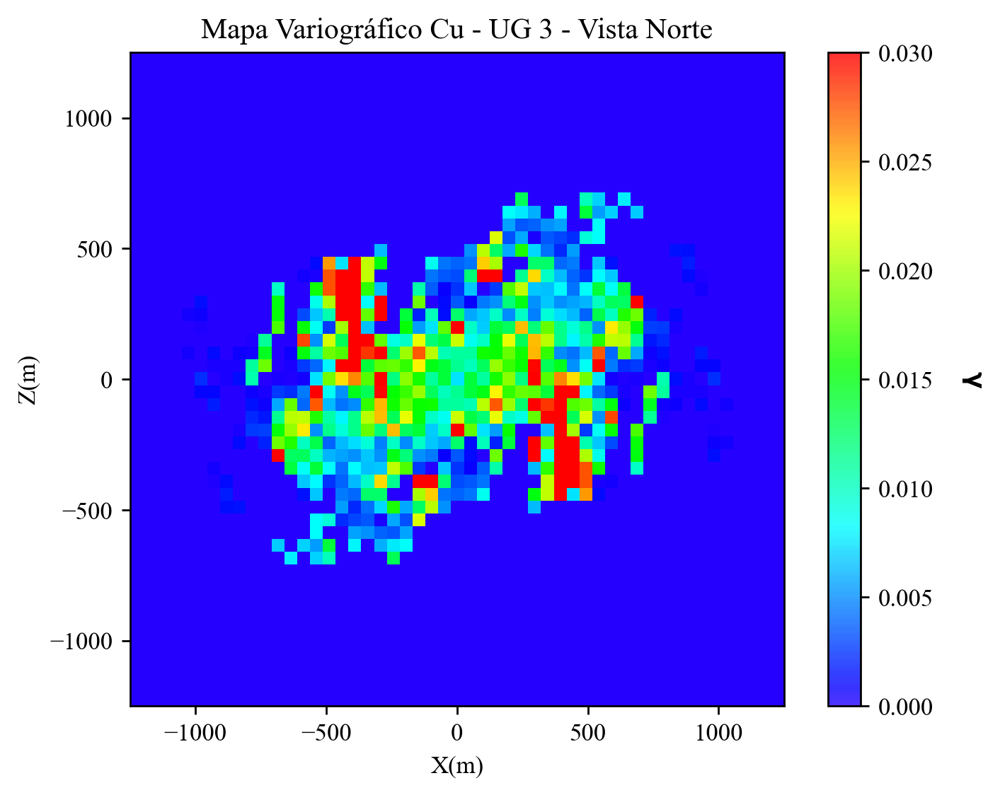

In [48]:

idz = 25; idy = 25; idx = 25   # índices para cortes en z, y, x respectivamente. Valores corresponden a nxlag/2, nylag/2, nzlag/2

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura | limites escala de colores  ↓   ↓   de 0.0 a 0.03  - Modificar si es necesario
GSLIB.pixelplt_st(varmap_UG3[idz,:,:],-nxlag*dxlag,nxlag*dxlag,-nylag*dylag,nylag*dylag,dzlag,0.0,0.03,'Mapa Variográfico Cu - UG 3 - Vista en planta','X(m)','Y(Mm)','$\mathbf{\gamma}$',cmap)

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura | limites escala de colores  ↓   ↓   de 0.0 a 0.03  - Modificar si es necesario
GSLIB.pixelplt_st(varmap_UG3[:,idy,:],-nylag*dylag,nylag*dylag,-nzlag*dzlag,nzlag*dzlag,dxlag,0.0,0.03,'Mapa Variográfico Cu - UG 3 - Vista Este','Y(m)','Z(m)','$\mathbf{\gamma}$',cmap)

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura | limites escala de colores  ↓   ↓   de 0.0 a 0.03  - Modificar si es necesario
GSLIB.pixelplt_st(varmap_UG3[:,:,idx],-nxlag*dxlag,nxlag*dxlag,-nzlag*dzlag,nzlag*dzlag,dxlag,0.0,0.03,'Mapa Variográfico Cu - UG 3 - Vista Norte','X(m)','Z(m)','$\mathbf{\gamma}$',cmap)

### Cálculo experimental del variograma

Definimos la siguiente función, que nos permitirá optimizar la ejecución del calculo de variogramas (Sólo ejecutar, sin modificar).

In [8]:
def gamv_3d(df, xcol, ycol, zcol, vcol, nlag, tmin,tmax, lagdist,lag_tol, azi, atol, bandh, dip, dtol, bandv, isill):
    """Calcula el variograma experimental 3D usando GSLIB GAMV."""
    lag = []
    gamma = []
    npair = []

    df_ext = pd.DataFrame({"X": df[xcol], "Y": df[ycol], "Z": df[zcol],"Variable": df[vcol]})
    GSLIB.Dataframe2GSLIB("01_data/gamv_out.dat", df_ext)

    with open("02_parametros/gamv.par", "w") as f:
        f.write("                  Parameters for GAMV                                      \n")
        f.write("                  *******************                                      \n")
        f.write("                                                                           \n")
        f.write("START OF PARAMETERS:                                                       \n")
        f.write("01_data/gamv_out.dat                    -file with data                            \n")
        f.write("1   2   3                         -   columns for X, Y, Z coordinates      \n")
        f.write("1   4   0                         -   number of variables,col numbers      \n")
        f.write( str(tmin) + " " + str(tmax)+ "  -   trimming limits                      \n")
        f.write("03_resultados/gamv.out                          -file for variogram output               \n")
        f.write(str(nlag) + "                      -number of lags                          \n")
        f.write(str(lagdist) + "                       -lag separation distance                 \n")
        f.write(str(lag_tol) + "                   -lag tolerance                           \n")
        f.write("1                                 -number of directions                    \n")
        f.write(str(azi) + " " + str(atol) + " " + str(bandh) + " " +str(dip) + " " + str(dtol) + " " + str(bandv)+ "  -azm,atol,bandh,dip,dtol,bandv \n")
        f.write(str(isill) + "                    -standardize sills? (0=no, 1=yes)        \n")
        f.write("1                                 -number of variograms                    \n")
        f.write("1   1   1                         -tail var., head var., variogram type    \n")

    # Ejecutar gamv de GSLIB
    result = subprocess.run(["./Gslib90/gamv", "./02_parametros/gamv.par"], capture_output=True, text=True, check=True)

    with open("03_resultados/gamv.out") as f:
        next(f)  # skip the first line

        for line in f:
            _, l, g, n, *_ = line.split()
            lag.append(float(l))
            gamma.append(float(g))
            npair.append(float(n))

    return lag, gamma, npair, result

def make_variogram3D(
    nug,
    nst,
    it1,
    cc1,
    azi1,
    dip1,
    hmaj1,
    hmin1,
    hvert1,
    it2=1,
    cc2=0,
    azi2=0,
    dip2=0,
    hmaj2=0,
    hmin2=0,
    hvert2=0,
    it3=1,
    cc3=0,
    azi3=0,
    dip3=0,
    hmaj3=0,
    hmin3=0,
    hvert3=0
):
    """Crea un variograma 3D con tres estructuras.
    """
    
    if cc2 == 0:
        nst = 1
    var = dict(
        [
            ("nug", nug),
            ("nst", nst),
            ("it", np.array([it1,it2,it3])),
            ("cc", np.array([cc1,cc2,cc3])),
            ("azi", np.array([azi1,azi2,azi3])),
            ("dip", np.array([dip1,dip2,dip3])),
            ("hmaj", np.array([hmaj1,hmaj2,hmaj3])),
            ("hmin", np.array([hmin1,hmin2,hmin3])),
            ("hvert", np.array([hvert1,hvert2,hvert3])),
        ]
    )

    return var

def vmodel(nlag,xlag,mazm,mdip,vario):
    """Calcula el variograma experimental 3D usando GSLIB VMODEL."""
    lag = []
    gamma = []

    with open("02_parametros/vmodel.par", "w") as f:
        f.write("                  Parameters for VMODEL                                      \n")
        f.write("                  *******************                                      \n")
        f.write("                                                                           \n")
        f.write("START OF PARAMETERS:                                                     \n")
        f.write("./03_resultados/vmodel.out                   -file for variogram output                 \n")
        f.write("1 " + str(nlag)+ "                          -number of directions and lags             \n")
        f.write(str(mazm) + " " + str(mdip) + " " + str(xlag) + "  -azm, dip, lag distance                     \n")
        f.write(str(vario["nst"]) + " " + str(vario['nug']) + "  -nst, nugget effect                        \n")
        f.write(str(vario["it"][0]) + " " + str(vario["cc"][0]) + " " + str(vario["azi"][0]) + " " + str(vario["dip"][0])  + "  0.0    -it,cc,ang1,ang2,ang3                       \n")
        f.write("         " + str(vario["hmaj"][0]) + " " + str(vario["hmin"][0]) + " " + str(vario["hvert"][0])  + "  -a_hmax, a_hmin, a_vert                    \n")
        f.write(str(vario["it"][1]) + " " + str(vario["cc"][1]) + " " + str(vario["azi"][1]) + " " + str(vario["dip"][1]) + "  0.0    -it,cc,ang1,ang2,ang3                       \n")
        f.write("         " + str(vario["hmaj"][1]) + " " + str(vario["hmin"][1]) + " " + str(vario["hvert"][1])  + "  -a_hmax, a_hmin, a_vert                    \n")
        f.write(str(vario["it"][2]) + " " + str(vario["cc"][2]) + " " + str(vario["azi"][2]) + " " + str(vario["dip"][2]) + "  0.0    -it,cc,ang1,ang2,ang3                       \n")
        f.write("         " + str(vario["hmaj"][2]) + " " + str(vario["hmin"][2]) + " " + str(vario["hvert"][2])  + "  -a_hmax, a_hmin, a_vert                    \n")
        
    # Ejecutar vmodel de GSLIB
    result = subprocess.run(["./Gslib90/vmodel", "./02_parametros/vmodel.par"], capture_output=True, text=True, check=True)

    with open("03_resultados/vmodel.out") as f:
        next(f)  # skip the first line

        for line in f:
            _, l, g, _, _, *_ = line.split()
            lag.append(float(l))
            gamma.append(float(g))

    return lag, gamma, result

Estamos listos para calcular los variogramas. Vamos a calcular variogramas direccionales para todas las UGs. Algunas notas sobre los parámetros:

* **number of variables,col numbers** indica el numero de variables a considerar (1, solo la variable de cobre en nuestro caso) y en que columna se encuentra esta variable en el archivo
* **trimming limits** son límites de recorte — establecidos para no tener impacto, no es necesario filtrar los datos.
* **lag separation distance**, **lag tolerance** son la distancia de lag y la tolerancia de lag — definidos según el espaciado común de los datos (50 m) y con una tolerancia del 100% de la distancia de lag para un mayor suavizado.
* **number of lags** es el número de lags — definido para extenderse un poco más allá del 20% del rango de los datos.
* **bandh** es el ancho de banda horizontal — configurado para no tener efecto.
* **bandv** es el ancho de banda vertical — configurado para no tener efecto.
* **azi** es el acimut — no tiene efecto porque hemos fijado atol (tolerancia de acimut) en 90.0.
* **standardize sills?** es un indicador para estandarizar la distribución a varianza 1 — no será usado durante este curso.
* **number of variograms** indica el numero de variogramas que calcularemos. 3 en nuestro caso (uno para cada indicador).
* **tail var., head var., variogram type** finalmente indicamos que variables entran en el cálculo del variograma y el tipo (variograma tradicional si el indicador es 1)


Probemos los siguiente parámetros para el cálculo del variograma en distintas direcciones (buscando alguna anisotropía) y visualicemos los resultados.

In [49]:
tmin = 0.; tmax = 9999; 
lag_dist = 30.0; lag_tol = 15.0; nlag = 10; bandh = 60; atol = 22.5; isill = 0; 
dip = 20; dtol = 12.5; bandv = 20; ## Mover estos parámetros a gusto del usuario

A continuación, solo modificamos la variable ```azi```

In [50]:
# Variograma experimental y búsqueda de anisotropías entre 0 y 165 grados

continuous = "cu_pct" # nombre de la variable continua

lag_0, gamma_0, npair_0, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 0, atol, bandh, dip, dtol, bandv, isill)
lag_15, gamma_15, npair_15, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 15, atol, bandh, dip, dtol, bandv, isill)
lag_30, gamma_30, npair_30, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 30, atol, bandh, dip, dtol, bandv, isill)
lag_45, gamma_45, npair_45, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 45, atol, bandh, dip, dtol, bandv, isill)
lag_60, gamma_60, npair_60, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 60, atol, bandh, dip, dtol, bandv, isill)
lag_75, gamma_75, npair_75, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 75, atol, bandh, dip, dtol, bandv, isill)
lag_90, gamma_90, npair_90, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 90, atol, bandh, dip, dtol, bandv, isill)
lag_105, gamma_105, npair_105, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 105, atol, bandh, dip, dtol, bandv, isill)
lag_120, gamma_120, npair_120, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 120, atol, bandh, dip, dtol, bandv, isill)
lag_135, gamma_135, npair_135, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 135, atol, bandh, dip, dtol, bandv, isill)
lag_150, gamma_150, npair_150, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 150, atol, bandh, dip, dtol, bandv, isill)
lag_165, gamma_165, npair_165, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 165, atol, bandh, dip, dtol, bandv, isill)


Ahora es posible visualizar los variogramas en las distintas direcciones.

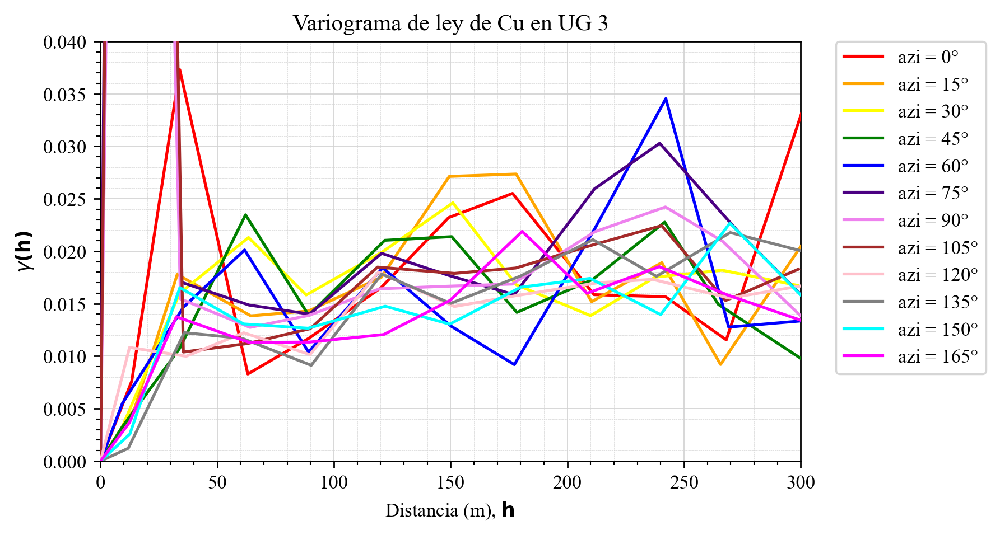

In [51]:
fig, ax = plt.subplots(figsize=(5,2.5))
ax.clear()

plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
plt.rcParams["font.family"] = "Times New Roman"

plt.plot(lag_0,gamma_0,color = 'red',label = 'azi = 0°',zorder=8)
plt.plot(lag_15,gamma_15,color = 'orange',label = 'azi = 15°',zorder=8)
plt.plot(lag_30,gamma_30,color = 'yellow',label = 'azi = 30°',zorder=8)
plt.plot(lag_45,gamma_45,color = 'green',label = 'azi = 45°',zorder=8)
plt.plot(lag_60,gamma_60,color = 'blue',label = 'azi = 60°',zorder=8)
plt.plot(lag_75,gamma_75,color = 'indigo',label = 'azi = 75°',zorder=8)
plt.plot(lag_90,gamma_90,color = 'violet',label = 'azi = 90°',zorder=8)
plt.plot(lag_105,gamma_105,color = 'brown',label = 'azi = 105°',zorder=8)
plt.plot(lag_120,gamma_120,color = 'pink',label = 'azi = 120°',zorder=8)
plt.plot(lag_135,gamma_135,color = 'gray',label = 'azi = 135°',zorder=8)
plt.plot(lag_150,gamma_150,color = 'cyan',label = 'azi = 150°',zorder=8)
plt.plot(lag_165,gamma_165,color = 'magenta',label = 'azi = 165°',zorder=8)

plt.xlabel(r'Distancia (m), $\bf{h}$ '); plt.ylabel(r'$\gamma \bf(h)$')
plt.title('Variograma de ley de Cu en UG 3')
plt.xlim([0,lag_dist*nlag]); plt.ylim([0,0.04]); plt.legend(loc='upper left');

## add grid lines
plt.grid(visible=True, which='major', color='lightgrey', linestyle='-', linewidth=0.5)
plt.grid(visible=True, which='minor', color='lightgrey', linestyle='--', linewidth=0.2)
plt.minorticks_on()

# mover legenda fuera del plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=1.2, wspace=0.2, hspace=0.3)
plt.show()

Estos variogramas son bastante feos pero igualmente nos permiten identificar la dirección de mayor continuidad, la cual identificamos aproximadamente en la dirección ``N30E``, dado su mayor alcance.

Reajustamos nuestros parámetros y calculamos esta vez el variograma en esta orientación y su orientación perpendicular ``N120E``.

In [39]:
lag_dist = 30.0; lag_tol = 30; nlag = 10; bandh = 50; atol = 22.5; isill = 0; 
dip = 10; dtol = 12.5; bandv = 50; ## Mover estos parámetros a gusto del usuario

In [40]:
continuous = "cu_pct" # nombre de la variable continua

az_max = 30 # dirección de máxima continuidad
az_min = 120  # dirección de mínima continuidad

lag_max, gamma_max, npair_max, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, az_max, atol, bandh, dip, dtol, bandv, isill)
lag_min, gamma_min, npair_min, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, az_min, atol, bandh, dip, dtol, bandv, isill)


Visualizamos los resultados.

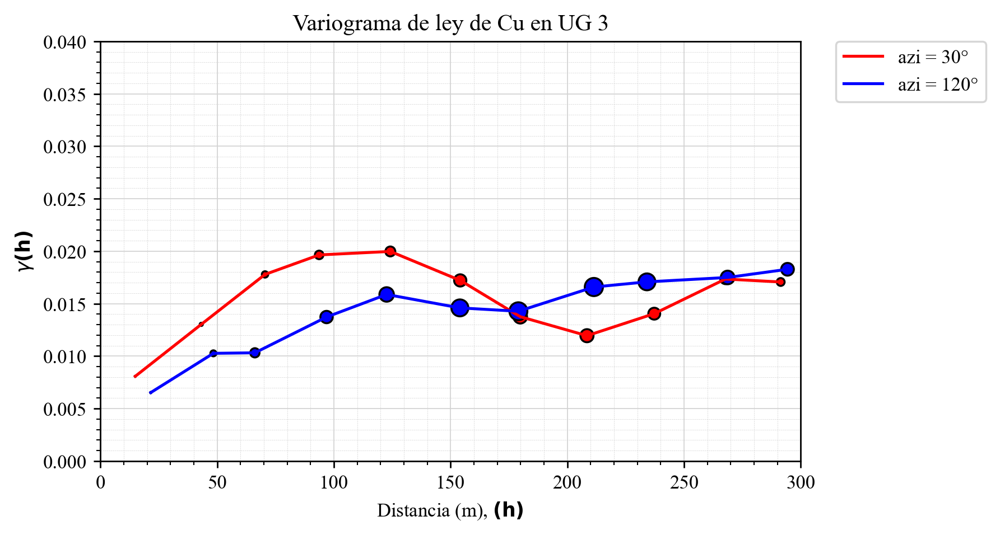

In [41]:
fig, ax = plt.subplots(figsize=(5,2.5))
ax.clear()

plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
plt.rcParams["font.family"] = "Times New Roman"


plt.plot(lag_max[1:],gamma_max[1:],color = 'red',label = 'azi = '+str(az_max)+'°',zorder=9)
plt.plot(lag_min[1:],gamma_min[1:],color = 'blue',label = 'azi = '+str(az_min)+'°',zorder=9)

plt.scatter(lag_max[1:],gamma_max[1:],color = 'red',edgecolor='black',s=np.multiply(npair_max[1:],0.01),marker='o',zorder=8)
plt.scatter(lag_min[1:],gamma_min[1:],color = 'blue',edgecolor='black',s=np.multiply(npair_min[1:],0.01),marker='o',zorder=8)

plt.xlabel(r'Distancia (m), $\bf(h)$ '); plt.ylabel(r'$\gamma \bf(h)$')
plt.title('Variograma de ley de Cu en UG 3')
plt.xlim([0,lag_dist*nlag]); plt.ylim([0,0.04]); plt.legend(loc='upper left');

## add grid lines
plt.grid(visible=True, which='major', color='lightgrey', linestyle='-', linewidth=0.5)
plt.grid(visible=True, which='minor', color='lightgrey', linestyle='--', linewidth=0.2)
plt.minorticks_on()

# mover legenda fuera del plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=1.2, wspace=0.2, hspace=0.3)
plt.show()

Continuamos calculando el variograma en la dirección vertical.

In [42]:
lag_dist = 20.0; lag_tol = 20.0; nlag = 15; bandh = 30; atol = 180; isill = 0;
dip_vert = 135; dtol = 15; bandv = 30; ## Mover estos parámetros a gusto del usuario

In [43]:
# Variograma experimental y búsqueda de anisotropías entre 0 y 165 grados

continuous = "cu_pct" # nombre de la variable continua

lag_vert, gamma_vert, npair_vert, result = gamv_3d(df,"X","Y","Z",continuous, nlag, tmin,tmax, lag_dist,lag_tol, 0, atol, bandh, dip_vert, dtol, bandv, isill)


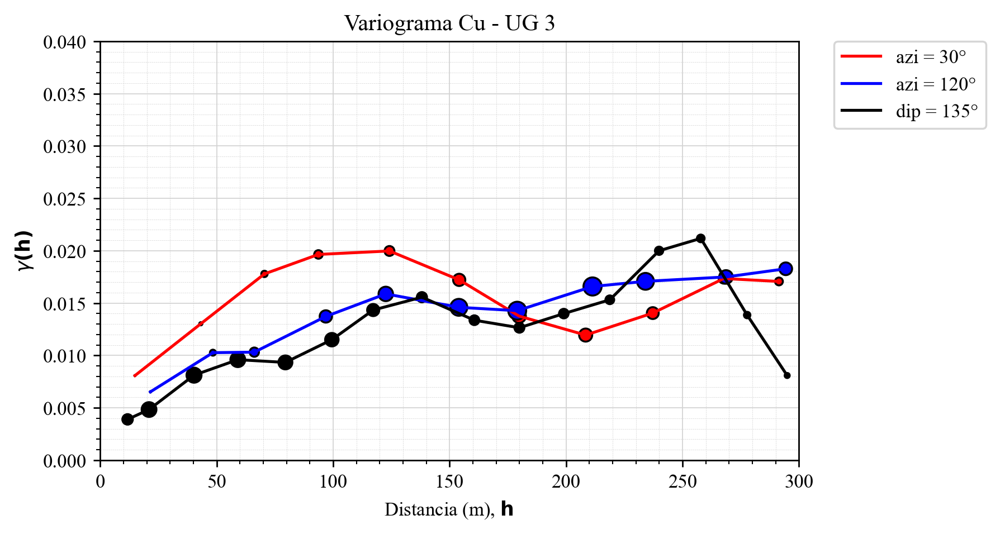

In [44]:
fig, ax = plt.subplots(figsize=(5,2.5))
ax.clear()

plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
plt.rcParams["font.family"] = "Times New Roman"

plt.plot(lag_max[1:],gamma_max[1:],color = 'red',label = 'azi = '+str(az_max)+'°',zorder=9)
plt.plot(lag_min[1:],gamma_min[1:],color = 'blue',label = 'azi = '+str(az_min)+'°',zorder=9)
plt.plot(lag_vert[1:],gamma_vert[1:],color = 'black',label = 'dip = '+str(dip_vert)+'°',zorder=9)


plt.scatter(lag_max[1:],gamma_max[1:],color = 'red',edgecolor='black',s=np.multiply(npair_max[1:],0.01),marker='o',zorder=8)
plt.scatter(lag_min[1:],gamma_min[1:],color = 'blue',edgecolor='black',s=np.multiply(npair_min[1:],0.01),marker='o',zorder=8)
plt.scatter(lag_vert[1:],gamma_vert[1:],color = 'black',edgecolor='black',s=np.multiply(npair_vert[1:],0.01),marker='o',zorder=8)

plt.xlabel(r'Distancia (m), $\bf{h}$ '); plt.ylabel(r'$\gamma \bf(h)$')
plt.title('Variograma Cu - UG 3')
plt.xlim([0,lag_dist*nlag]); plt.ylim([0,0.04]); plt.legend(loc='upper left');

## add grid lines
plt.grid(visible=True, which='major', color='lightgrey', linestyle='-', linewidth=0.5)
plt.grid(visible=True, which='minor', color='lightgrey', linestyle='--', linewidth=0.2)
plt.minorticks_on()

# mover legenda fuera del plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)


plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=1.2, wspace=0.2, hspace=0.3)
plt.show()

Usamos la función make_variogram de GeostatsPy para construir un modelo de variograma.Esta función actúa como  un diccionario para almacenar de forma compacta los parámetros del modelo de variograma que se usan en la visualización, kriging y simulación.

Los parámetros del modelo de variograma incluyen:

- **nug** - aporte del efecto pepita (nugget) a la meseta (sill)
- **nst** - número de estructuras anidadas (1, 2 o 3)
- **it** - tipo para la estructura (1 - esférico, 2 - exponencial, 3 - gaussiano)
- **cc** - contribución de cada estructura anidada (las contribuciones + nugget deben sumar la meseta)
- **azi** - acimut para esta estructura (dirección mayor), la minor es ortogonal
- **hmaj** - alcance en la dirección mayor
- **hmin** - alcance en la dirección menor

Si solo usamos 1 estructura (más opción de nugget), omita los parámetros de la segunda estructura y estos por defecto serán $cc2 = 0$ (sin contribución).

Después de algunas iteraciones, mi ajuste para la ley de cobre en la UG3 es el siguiente:

In [ ]:
nug = 0.003; nst = 3     # definimos el efecto pepa (0.0) y el número de estructuras anidadas (1)
it1 = 2; cc1 = 0.022; azi1 = az_max; dip1=dip; hmaj1 = 200; hmin1 = 100; hvert1 = 90;  # 1 estructura anidada (exponencial)
it2 = 2; cc2 = 0.005; azi2 = az_max; dip2=dip; hmaj2 = 9999; hmin2 = 100; hvert2 = 90;  # 1 estructura anidada (exponencial)
it3 = 2; cc3 = 0.005; azi3 = az_max; dip3=dip; hmaj3 = 9999; hmin3 = 9999; hvert3 = 90;  # 1 estructura anidada (exponencial)

vario_cu_UG3 = make_variogram3D(nug,nst,it1,cc1,azi1,dip1,hmaj1,hmin1,hvert1,it2,cc2,azi2,dip2,hmaj2,hmin2,hvert2,it3,cc3,azi3,dip3,hmaj3,hmin3,hvert3)  # crear el objeto del modelo de variograma

### Trazado del modelo de variograma

Para trazar el variograma usamos el programa `vmodel` de la GSLIB que proyecta el modelo a un conjunto de distancias de lag en las direcciones mayor y menor.

Las entradas para `vmodel` son:

- **nlag** - número de puntos a lo largo del variograma para la proyección
- **xlag** - tamaño del lag para la proyección
- **azm** - dirección de la proyección en azimut (trabajamos en 2D)
- **vario** - el diccionario del modelo de variograma creado con `make_variogram`

Nota: esta función es solo para visualización; por eso es habitual usar un **xlag** muy pequeño y un **nlag** grande para una visualización de alta resolución del modelo.

Las salidas de `vmodel` incluyen:

- **lag distance** - distancia offset a lo largo de la proyección (el $\mathbf{h}$ en el gráfico)
- **variogram** - valor del variograma en esa distancia de lag (el $\gamma(\mathbf{h})$)
- **resutls** - verificación de la correcta ejecución (imprimir en caso de que algo ande mal)

Tenemos 2 estructuras y sin efecto pepa como ejemplo para el caso de la UG 2.  

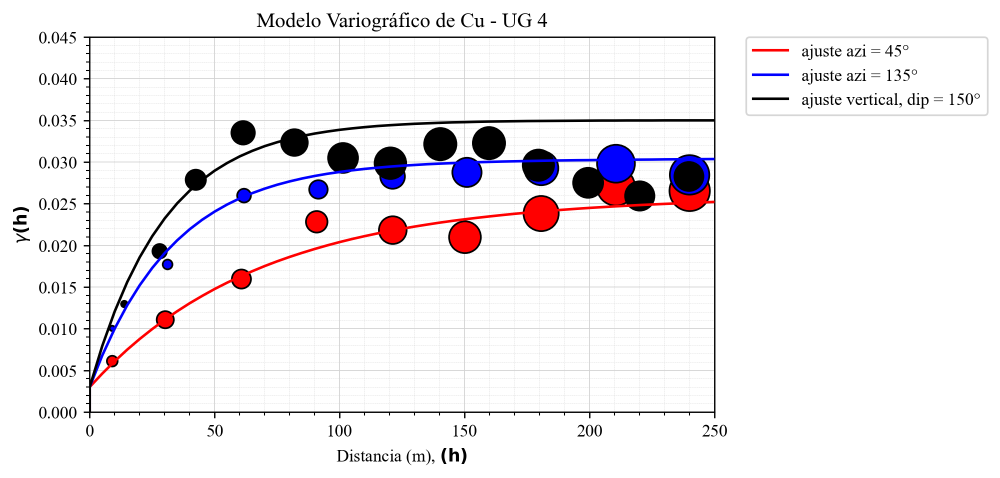

In [ ]:
nlag = 50; xlag = 5; a_max = az_max; dip_p = dip;  # project the model in max range azimuth
h_max , gam_max , result = vmodel(nlag,xlag,a_max,dip_p,vario_cu_UG3)

nlag = 50; xlag = 5; a_min = az_min; dip_p = 0;  # project the model in min range azimuth
h_min , gam_min , result = vmodel(nlag,xlag,a_min,dip_p,vario_cu_UG3)

nlag = 50; xlag = 5; a_vert = az_max; dip_p = dip_vert;  # project the model in vertical direction
h_vert , gam_vert , result = vmodel(nlag,xlag,a_vert,dip_p,vario_cu_UG3)

fig, ax = plt.subplots(figsize=(5,2.5))
ax.clear()

plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
plt.rcParams["font.family"] = "Times New Roman"

plt.scatter(lag_max[1:],gamma_max[1:],color = 'red',edgecolor='black',s=np.multiply(npair_max[1:],0.02),marker='o',zorder=8)
plt.scatter(lag_min[1:],gamma_min[1:],color = 'blue',edgecolor='black',s=np.multiply(npair_min[1:],0.02),marker='o',zorder=8)
plt.scatter(lag_vert[1:],gamma_vert[1:],color = 'black',edgecolor='black',s=np.multiply(npair_vert[1:],0.01),marker='o',zorder=8)

plt.plot(h_max,gam_max,color = 'red',label = 'ajuste azi = '+str(az_max)+'°',zorder=9)
plt.plot(h_min,gam_min,color = 'blue',label = 'ajuste azi = '+str(az_min)+'°',zorder=9)
plt.plot(h_vert,gam_vert,color = 'black',label = 'ajuste vertical, dip = '+str(dip_p)+'°',zorder=9)

plt.xlabel(r'Distancia (m), $\bf(h)$ '); plt.ylabel(r'$\gamma \bf(h)$')
plt.title('Modelo Variográfico de Cu - UG 3')
plt.xlim([0,nlag*xlag]); plt.ylim([0,0.045]); plt.legend(loc='upper left');

## add grid lines
plt.grid(visible=True, which='major', color='lightgrey', linestyle='-', linewidth=0.5)
plt.grid(visible=True, which='minor', color='lightgrey', linestyle='--', linewidth=0.2)
plt.minorticks_on()

# mover legenda fuera del plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=1.2, wspace=0.2, hspace=0.3)
plt.show()

## Selección de plan de estimación

### Validación cruzada mediante Kriging para variables continuas - Ley de Cu - UG 3

Aplicamos los conceptos desarrollados anteriormente y el modelo de variograma obtenido para cada la ley de Cu.

Esta sección presenta los programas de kriging de GSLIB. Estos programas permiten la validación cruzada mediante kriging simple (SK), kriging ordinario (OK) y kriging con varios modelos de tendencia (KT).

El programa ```kt3d``` ofrece un programa de kriging 3D bastante avanzado para puntos o bloques mediante kriging simple (SK), kriging ordinario (OK) o kriging con un modelo de tendencia polinómica (no sera revisado en este curso).

Los parámetros requeridos por el programa principal ```kt3d``` se listan a continuación:

- **datafl**: archivo de entrada con los datos en formato GSLIB.
- **DH, X, Y, Z, icolvr, icolsec**: columnas para la columna que contiene los codigos DH (ya los borramos y no serán necesarios - valor 0) coordenadas x, y, z, la variable a estimar y la variable de deriva externa (o media no estacionaria - no utilizada en este curso).
- **tmin y tmax**: triming limits o valores fuera de este rango (menores estrictamente que tmin o mayores o iguales que tmax) se ignoran.**: valores fuera de este rango (menores estrictamente que tmin o mayores o iguales que tmax) se ignoran.**.
- **option**: 0 para kriging sobre una rejilla de puntos o bloques, 1 para valida validación cruzada con los datos en datafl, 2 para jackknife con los datos del archivo siguiente.
- **jackfl**: archivo con las ubicaciones para realizar estimaciones (opción jackknife).
- **icoljx, icoljy, icoljz, icoljvr, icoljsec**: columnas para x, y, z, la variable y la variable secundaria en jackfl.kfl.
- **idbg**: nivel entero de depuración entre 0 y 3. A mayor nivel, más información entregada. Los niveles usuales son 0 y 1; 2 y 3 imprimen todas las matrices de kriging y datos usados para cada punto/bloque (no recomendable con grillas grandes).
- **dbgfl**: archivo donde se escribe la salida de depuración.
- **outfl**: archivo de salida de la rejilla. Contiene la estimación y la varianza de kriging para cada punto/bloque en la rejilla, con orden rápido en x, luego y y finalmente z. Los puntos no estimados se marcan con un número negativo grande (-999.).
- **nx, xmn, xsiz**: definición de la grilla en la dirección x.
- **ny, ymn, ysiz**: definición de la grilla en la dirección y.
- **nz, zmn, zsiz**: definición de la grilla en la dirección z.
- **nxdis, nydis, nzdis**: número de puntos de discretización para un bloque. Si nxdis, nydis y nzdis son 1, se realiza kriging puntual.
- **ndmin y ndmax**: número mínimo y máximo de datos a usar para kriging de un bloque.
- **noct**: máximo a retener por octante (no se usa búsqueda por octantes si noct = 0).i noct = 0).
- **radius_hmax, radius_hmin, radius_vert**: radios de búsqueda en la dirección horizontal máxima, horizontal mínima y vertical.
- **sang1, sang2, sang3**: ángulos que describen la orientación de la elipsoide de búsqueda (anisotropía).
- **ikrige y skmean**: si ikrige = 0 se realiza kriging simple estacionario con media **skmean**; si ikrige = 1 se realiza kriging ordinario y el valor de skmean no es considerado.
- **nst y c0**: número de estructuras del variograma y constante nugget. El efecto pepita no se cuenta como estructura.

Para cada una de las nst estructuras anidadas se debe definir el tipo (it), la contribución (cc), los ángulos (azi, dip) y los alcances (a_hmax, a_hmin, a_vert).

Es importante señalar que de acuerdo a cual sea nuestro objetivo ---validación cruzada o estimación de bloques--- dependerán los parámetros que modificamos en el archivo de parámetros.

#### Plan de búsqueda sin uso de octantes
Vemos como queda nuestro archivo de parámetros para la UG 3, **en un primer caso sin consideración de octantes, y buscando 24 datos**. **Recuerda utilizar en la parte final el modelo variográfico correspondiente a esta UG**

In [52]:
parfile = '''                  Parameters for KT3D
                  *******************

START OF PARAMETERS:
./01_data/data_UG3.dat              -file with data
0  1  2  3  4  0                 -   columns for DH,X,Y,Z,var,sec var
-1.0e21   1.0e21                 -   trimming limits
1                                -option: 0=grid, 1=cross, 2=jackknife - AR : usamos la opción 1 de cross-validation
xvk.dat                          -file with jackknife data - AR : no se usa en este caso
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var - AR : no se usa en este caso
0                                -debugging level: 0,1,2,3
./03_resultados/kt3d-pt-cross_UG3.dbg                   -file for debugging output
./03_resultados/kt3d-pt-cross_UG3.out                   -file for kriged output
128   471116.24    15			-nx,xmn,xsiz - AR : no se usa en este caso debido a cross-validation
97   6924721.57    15			-ny,ymn,ysiz - AR : no se usa en este caso debido a cross-validation
100   2950.02    15			    -nz,zmn,zsiz - AR : no se usa en este caso debido a cross-validation
1    1      1                    -x,y and z block discretization
20    24                           -min, max data for kriging - AR : uso de 8 datos para el krigeo
0                                -max per octant (0-> not used) - AR : 0 si no se desea usar octantes
200.0  100.0  90.0                -maximum search radii - AR : radios de búsqueda de acuerdo a alcances de variograma
 45   60   0.0                 -angles for search ellipsoid - AR : ángulos de búsqueda de acuerdo a azimuts y dips principales del variograma
1     0.37                      -0=SK,1=OK,2=non-st SK,3=exdrift - AR : uso de kriging ordinario, segundo valor no es relevante en este caso
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.dat                     -gridded file with drift/mean
4                                -  column number in gridded file
3 0.003  -nst, nugget effect  - AR: variograma de CU para UG 3  modelado en sección anterior                       
2 0.022 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         200 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 9999 90  -a_hmax, a_hmin, a_vert          
'''

with open("02_parametros/kt3d_cross_UG3.par", "w") as f:
    f.write(parfile)

Ahora ya podemos ejecutar `kt3d` de GSLIB. Puede tardar varios minutos dependiendo del tamaño de la grilla definida.

In [53]:
# Ejecutar kt3d de GSLIB
result = subprocess.run(["./Gslib90/kt3d", "./02_parametros/kt3d_cross_UG3.par"], capture_output=True, text=True, check=True)

Leemos la salida del programa. Solo es necesario modificar el nombre del archivo.

In [54]:
ValReal = []
Estim = []
Error = []

with open("./03_resultados/kt3d-pt-cross_UG3.out") as f:
    head = [next(f) for _ in range(2)]  # read first two lines
    line2 = head[1].split()
    ncol = int(line2[0])  # get the number of columns

    for icol in range(ncol):  # read over the column names
        head = next(f)

    for line in f:
        _,_,_, l, m, _, n = line.split()
        # skip si es -999
        if float(m) < -99:
            continue
        ValReal.append(float(l))
        Estim.append(float(m))
        Error.append(float(n))

Ahora es posible mostrar los resultados principales de la validación cruzada: el scatterplot entre **valores reales vs estimados**, y el **histograma de errores** (valor real - valor estimado), respectivamente. En base a estas gráficas definiremos cual es el mejor plan de estimación.

##### Scatter plot entre valores reales vs estimados

Buscamos aquel plan en donde coeficiente de correlación entre los valores estimados y los valores de los datos sea lo más cercano posible a 1.


In [55]:
## Plot de validación cruzada
import plotly.graph_objects as go

# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode

fig = go.Figure()
fig.add_trace(go.Scatter(x=ValReal, y=Estim, mode='markers',
                         marker=dict(color='black', size=5, opacity=0.7),
                         name='Puntos de Validación Cruzada'))

# Añadir línea de 1:1 entre 0 y maximo valor de ValReal y Estim
max_val = max(max(ValReal), max(Estim))
fig.add_trace(go.Scatter(x=[0, max_val], y=[0, max_val], mode='lines',
                         line=dict(color='red', dash='dash'),
                         name='Línea 1:1'))

# Agregar información estadística en recuadro hacia abajo
media_real = sum(ValReal) / len(ValReal)
media_estim = sum(Estim) / len(Estim)
var_real = sum((x - media_real) ** 2 for x in ValReal) / len(ValReal)
var_estim = sum((x - media_estim) ** 2 for x in Estim) / len(Estim)
corr = np.corrcoef(ValReal, Estim)[0, 1]

stats_text = (f'Numero de Muestras: {len(ValReal)}\n'
              f'Media Real: {media_real:.2f}\n'
              f'Media Estimada: {media_estim:.2f}\n'
              f'Varianza Real: {var_real:.2f}\n'
              f'Varianza Estimada: {var_estim:.2f}\n'
              f'Correlación: {corr:.2f}\n'
              f'Rango Real: {min(ValReal):.2f} - {max(ValReal):.2f}\n'
              f'Rango Estimado: {min(Estim):.2f} - {max(Estim):.2f}'
              )

fig.add_annotation(
    x=max_val * 0.85,
    y=max_val * 0.25,
    xref="x",
    yref="y",
    text=stats_text.replace('\n', '<br>'),
    showarrow=False,
    align="left",
    font=dict(family="Times New Roman", size=20, color="black"),
    bordercolor="black",
    borderwidth=1,
    borderpad=10,
    bgcolor="white",
    opacity=0.8
)

fig.update_layout(
    title='Val. Cruzada K.O. - Cu - UG 3 - 24 muestras, sin Oct.',
    xaxis_title='Valor Real (Cu %)',
    yaxis_title='Valor Estimado (Cu %)',
    xaxis=dict(range=[0, max_val], scaleanchor="y", scaleratio=1),
    yaxis=dict(range=[0, max_val]),
    width=600,
    height=600,
    showlegend=False,
    hovermode=False,
    font=dict(family="Times New Roman", size=18, color="black"),
    plot_bgcolor='white',
    xaxis_gridcolor='lightgrey',
    yaxis_gridcolor='lightgrey'
)
fig.show()

##### Histograma de errores

Se busca que el plan de estimación genere errores con las siguientes características:

* Las medias de los errores y de los errores estandarizados miden el **sesgo** del estimador, y deben ser cercanas a cero. De hecho, este criterio resulta secundario con respecto al modelamiento del variograma y la elección de la vecindad de kriging pues los valores obtenidos por kriging son insesgados por construcción. Así, en la práctica, la media de los errores tenderá hacia cero.
* La varianza de los errores, que mide la precisión del estimador, debe ser mínima


In [56]:
# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode
# Histograma de errores
media_error = sum(Error) / len(Error)
var_error = sum((x - media_error) ** 2 for x in Error) / len(Error)

# Histograma de errores (eje x entre percentil 1 y 99), 10 barras, con recuadro de estadísticas
p1, p99 = np.percentile(Error, [1, 99])
errs = np.array(Error)
errs_clip = errs[(errs >= p1) & (errs <= p99)]

fig = go.Figure()
fig.add_trace(go.Histogram(
    x=errs_clip,
    nbinsx=10,
    marker=dict(color='black', line=dict(color='black', width=1))
))

stats_text = f"Media Error: {media_error:.2f}<br>Var Error: {var_error:.2f}<br>Rango: {min(Error):.2f} , {max(Error):.2f}"

fig.add_annotation(
    x=1.1, y=0.95, xref="paper", yref="paper",
    text=stats_text, showarrow=False, align="left",
    font=dict(family="Times New Roman", size=15, color="black"),
    bordercolor="black", borderwidth=1, borderpad=8, bgcolor="white", opacity=0.9
)

fig.update_layout(
    title='His. de Error - K.O. - Cu - UG 3 - 24 muestras, sin Oct.',
    xaxis_title='Error de Estimación (Cu %)',
    yaxis_title='Frecuencia',
    xaxis=dict(range=[p1, p99], gridcolor='lightgrey'),
    yaxis=dict(gridcolor='lightgrey'),
    plot_bgcolor='white',
    width=500, height=400,
    font=dict(family="Times New Roman", size=15, color="black"),
    showlegend=False
)

fig.show()


#### Plan de búsqueda con uso de octantes
Vemos como queda nuestro archivo de parámetros para la UG 3, **en un segundo caso considerando el uso de octantes, y buscando 24 datos**.

In [57]:
parfile = '''                  Parameters for KT3D
                  *******************

START OF PARAMETERS:
./01_data/data_UG3.dat              -file with data
0  1  2  3  4  0                 -   columns for DH,X,Y,Z,var,sec var
-1.0e21   1.0e21                 -   trimming limits
1                                -option: 0=grid, 1=cross, 2=jackknife - AR : usamos la opción 1 de cross-validation
xvk.dat                          -file with jackknife data - AR : no se usa en este caso
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var - AR : no se usa en este caso
0                                -debugging level: 0,1,2,3
./03_resultados/kt3d-pt-cross_UG3.dbg                   -file for debugging output
./03_resultados/kt3d-pt-cross_UG3.out                   -file for kriged output
128   471116.24    15			-nx,xmn,xsiz - AR : no se usa en este caso debido a cross-validation
97   6924721.57    15			-ny,ymn,ysiz - AR : no se usa en este caso debido a cross-validation
100   2950.02    15			    -nz,zmn,zsiz - AR : no se usa en este caso debido a cross-validation
1    1      1                    -x,y and z block discretization
20    24                           -min, max data for kriging - AR : uso de 24 datos para el krigeo
3                                -max per octant (0-> not used) - AR : número de muestras por octante
200.0  100.0  90.0                -maximum search radii - AR : radios de búsqueda de acuerdo a alcances de variograma
 45   60   0.0                 -angles for search ellipsoid - AR : ángulos de búsqueda de acuerdo a azimuts y dips principales del variograma
1     0.37                      -0=SK,1=OK,2=non-st SK,3=exdrift - AR : uso de kriging ordinario, segundo valor no es relevante en este caso
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.dat                     -gridded file with drift/mean
4                                -  column number in gridded file
3 0.003  -nst, nugget effect  - AR: variograma de CU para UG 3  modelado en sección anterior                       
2 0.022 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         200 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 9999 90  -a_hmax, a_hmin, a_vert          
'''

with open("02_parametros/kt3d_cross_UG3.par", "w") as f:
    f.write(parfile)

Ahora ya podemos ejecutar ``kt3d`` de GSLIB. Puede tardar varios minutos dependiendo del tamaño de la grilla definida.

In [58]:
# Ejecutar kt3d de GSLIB
result = subprocess.run(["./Gslib90/kt3d", "./02_parametros/kt3d_cross_UG3.par"], capture_output=True, text=True, check=True)

In [59]:
ValReal = []
Estim = []
Error = []

with open("./03_resultados/kt3d-pt-cross_UG3.out") as f:
    head = [next(f) for _ in range(2)]  # read first two lines
    line2 = head[1].split()
    ncol = int(line2[0])  # get the number of columns

    for icol in range(ncol):  # read over the column names
        head = next(f)

    for line in f:
        _,_,_, l, m, _, n = line.split()
        # skip si es -999
        if float(m) < -99:
            continue
        ValReal.append(float(l))
        Estim.append(float(m))
        Error.append(float(n))

In [60]:
## Plot de validación cruzada
import plotly.graph_objects as go

# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode

fig = go.Figure()
fig.add_trace(go.Scatter(x=ValReal, y=Estim, mode='markers',
                         marker=dict(color='black', size=5, opacity=0.7),
                         name='Puntos de Validación Cruzada'))

# Añadir línea de 1:1 entre 0 y maximo valor de ValReal y Estim
max_val = max(max(ValReal), max(Estim))
fig.add_trace(go.Scatter(x=[0, max_val], y=[0, max_val], mode='lines',
                         line=dict(color='red', dash='dash'),
                         name='Línea 1:1'))

# Agregar información estadística en recuadro hacia abajo
media_real = sum(ValReal) / len(ValReal)
media_estim = sum(Estim) / len(Estim)
var_real = sum((x - media_real) ** 2 for x in ValReal) / len(ValReal)
var_estim = sum((x - media_estim) ** 2 for x in Estim) / len(Estim)
corr = np.corrcoef(ValReal, Estim)[0, 1]

stats_text = (f'Numero de Muestras: {len(ValReal)}\n'
              f'Media Real: {media_real:.2f}\n'
              f'Media Estimada: {media_estim:.2f}\n'
              f'Varianza Real: {var_real:.2f}\n'
              f'Varianza Estimada: {var_estim:.2f}\n'
              f'Correlación: {corr:.2f}\n'
              f'Rango Real: {min(ValReal):.2f} - {max(ValReal):.2f}\n'
              f'Rango Estimado: {min(Estim):.2f} - {max(Estim):.2f}'
              )

fig.add_annotation(
    x=max_val * 0.85,
    y=max_val * 0.25,
    xref="x",
    yref="y",
    text=stats_text.replace('\n', '<br>'),
    showarrow=False,
    align="left",
    font=dict(family="Times New Roman", size=20, color="black"),
    bordercolor="black",
    borderwidth=1,
    borderpad=10,
    bgcolor="white",
    opacity=0.8
)

fig.update_layout(
    title='Val. Cruzada K.O. - Cu - UG 3 - 24 muestras, con Oct.',
    xaxis_title='Valor Real (Cu %)',
    yaxis_title='Valor Estimado (Cu %)',
    xaxis=dict(range=[0, max_val], scaleanchor="y", scaleratio=1),
    yaxis=dict(range=[0, max_val]),
    width=600,
    height=600,
    showlegend=False,
    hovermode=False,
    font=dict(family="Times New Roman", size=18, color="black"),
    plot_bgcolor='white',
    xaxis_gridcolor='lightgrey',
    yaxis_gridcolor='lightgrey'
)
fig.show()

In [61]:
# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode
# Histograma de errores
media_error = sum(Error) / len(Error)
var_error = sum((x - media_error) ** 2 for x in Error) / len(Error)

# Histograma de errores (eje x entre percentil 1 y 99), 10 barras, con recuadro de estadísticas
p1, p99 = np.percentile(Error, [1, 99])
errs = np.array(Error)
errs_clip = errs[(errs >= p1) & (errs <= p99)]

fig = go.Figure()
fig.add_trace(go.Histogram(
    x=errs_clip,
    nbinsx=10,
    marker=dict(color='black', line=dict(color='black', width=1))
))

stats_text = f"Media Error: {media_error:.2f}<br>Var Error: {var_error:.2f}<br>Rango: {min(Error):.2f} , {max(Error):.2f}"

fig.add_annotation(
    x=1.1, y=0.95, xref="paper", yref="paper",
    text=stats_text, showarrow=False, align="left",
    font=dict(family="Times New Roman", size=15, color="black"),
    bordercolor="black", borderwidth=1, borderpad=8, bgcolor="white", opacity=0.9
)

fig.update_layout(
    title='His. de Error - K.O. - Cu - UG 3 - 24 muestras, con Oct.',
    xaxis_title='Error de Estimación (Cu %)',
    yaxis_title='Frecuencia',
    xaxis=dict(range=[p1, p99], gridcolor='lightgrey'),
    yaxis=dict(gridcolor='lightgrey'),
    plot_bgcolor='white',
    width=500, height=400,
    font=dict(family="Times New Roman", size=15, color="black"),
    showlegend=False
)

fig.show()


Debido a que el primer plan de estimación cuenta con mayor correlación y menor varianza de errores en comparación con el segundo, nos quedamos con el primer plan.

## Parámetros de la malla 3D de estimación

Antes de continuar con la estimación, definamos los parámetros de la malla 3D donde se realizará la estimación de las UGs, calculadas ya en la sección anterior.

In [62]:
xmin = 471116.24; xmax = 473023.89			# rango de valores x
ymin = 6924721.57; ymax = 6926164.63			# rango de valores y
zmin = 2950.02; zmax = 4445.78				# rango de valores z

xsiz = 15; ysiz = 15; zsiz = 15				# tamaño de celda
nx = 128; ny = 97; nz = 100				# número de celdas

tmin = -999; tmax = 999;                                      # límites de recorte de datos

# calculo automático del centro de las capas y cortes para plotear, no modificar

icx = int(nx/2); cx = xmin + icx*xsiz
icy = int(ny/2); cy = ymin + icy*ysiz
icz = int(nz/2); cz = zmin + icz*zsiz


## Kriging para variables continuas - Ley de Cu - UG 3

Ahora utilizamos el programa para generar un modelo de bloques de estimación. Aplicamos los conceptos desarrollados anteriormente y el modelo de variograma obtenidos para la UG bajo análisis.

Este capítulo presenta los programas de kriging de GSLIB. Estos programas permiten estimar un volumen ya sea usando kriging simple (SK), kriging ordinario (OK) o kriging con tendencias (KT).

Esta sección ```kt3d``` ofrece un programa de kriging 3D bastante avanzado para puntos o bloques mediante kriging simple (SK), kriging ordinario (OK) o kriging con un modelo de tendencia polinómica (no sera revisado en este curso).

Los parámetros requeridos por el programa principal ```kt3d``` se listan a continuación:

- **datafl**: archivo de entrada con los datos en formato GSLIB.
- **DH, X, Y, Z, icolvr, icolsec**: columnas para la columna que contiene los codigos DH (ya los borramos y no seran necesarios - valor 0) coordenadas x, y, z, la variable a estimar y la variable de deriva externa (o media no estacionaria - no utilizada en este curso).
- **tmin y tmax**: triming limits o valores fuera de este rango (menores estrictamente que tmin o mayores o iguales que tmax) se ignoran.**: valores fuera de este rango (menores estrictamente que tmin o mayores o iguales que tmax) se ignoran.**.
- **option**: 0 para kriging sobre una rejilla de puntos o bloques, 1 para valida validación cruzada con los datos en datafl, 2 para jackknife con los datos del archivo siguiente.
- **jackfl**: archivo con las ubicaciones para realizar estimaciones (opción jackknife).
- **icoljx, icoljy, icoljz, icoljvr, icoljsec**: columnas para x, y, z, la variable y la variable secundaria en jackfl.kfl.
- **idbg**: nivel entero de depuración entre 0 y 3. A mayor nivel, más información entregada. Los niveles usuales son 0 y 1; 2 y 3 imprimen todas las matrices de kriging y datos usados para cada punto/bloque (no recomendable con grillas grandes).
- **dbgfl**: archivo donde se escribe la salida de depuración.
- **outfl**: archivo de salida de la rejilla. Contiene la estimación y la varianza de kriging para cada punto/bloque en la rejilla, con orden rápido en x, luego y y finalmente z. Los puntos no estimados se marcan con un número negativo grande (-999.).
- **nx, xmn, xsiz**: definición de la grilla en la dirección x.
- **ny, ymn, ysiz**: definición de la grilla en la dirección y.
- **nz, zmn, zsiz**: definición de la grilla en la dirección z.
- **nxdis, nydis, nzdis**: número de puntos de discretización para un bloque. Si nxdis, nydis y nzdis son 1, se realiza kriging puntual.
- **ndmin y ndmax**: número mínimo y máximo de datos a usar para kriging de un bloque.
- **noct**: máximo a retener por octante (no se usa búsqueda por octantes si noct = 0).i noct = 0).
- **radius_hmax, radius_hmin, radius_vert**: radios de búsqueda en la dirección horizontal máxima, horizontal mínima y vertical.
- **sang1, sang2, sang3**: ángulos que describen la orientación de la elipsoide de búsqueda (anisotropía).
- **ikrige y skmean**: si ikrige = 0 se realiza kriging simple estacionario con media **skmean**; si ikrige = 1 se realiza kriging ordinario y el valor de skmean no es considerado.
- **nst y c0**: número de estructuras del variograma y constante nugget. El efecto pepita no se cuenta como estructura.

Para cada una de las nst estructuras anidadas se debe definir el tipo (it), la contribución (cc), los ángulos (azi, dip) y los alcances (a_hmax, a_hmin, a_vert).

Vemos como queda nuestro archivo de parámetros para la UG 3.


In [63]:
parfile = '''                  Parameters for KT3D
                  *******************

START OF PARAMETERS:
./01_data/data_UG3.dat              -file with data
0  1  2  3  4  0                 -   columns for DH,X,Y,Z,var,sec var
-1.0e21   1.0e21                 -   trimming limits
0                                -option: 0=grid, 1=cross, 2=jackknife
xvk.dat                          -file with jackknife data
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var
0                                -debugging level: 0,1,2,3
./03_resultados/kt3d-bl_UG3.dbg                   -file for debugging output
./03_resultados/kt3d-bl_UG3.out                   -file for kriged output
128   471116.24    15			-nx,xmn,xsiz - AR: pegamos los valores de la grilla definida en la sección anterior
97   6924721.57    15			-ny,ymn,ysiz
100   2950.02    15			    -nz,zmn,zsiz
4    4      2                    -x,y and z block discretization
12    24                           -min, max data for kriging - AR : uso de 24 datos para el krigeo
3                                -max per octant (0-> not used) - AR : número de muestras por octante
200.0  100.0  90.0                -maximum search radii - AR : radios de búsqueda de acuerdo a alcances de variograma
 45   60   0.0                 -angles for search ellipsoid - AR : ángulos de búsqueda de acuerdo a azimuts y dips principales del variograma
1     0.37                      -0=SK,1=OK,2=non-st SK,3=exdrift - AR : uso de kriging ordinario, segundo valor no es relevante en este caso
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.dat                     -gridded file with drift/mean
4                                -  column number in gridded file
3 0.003  -nst, nugget effect  - AR: variograma de CU para UG 3  modelado en sección anterior                       
2 0.022 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         200 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 9999 90  -a_hmax, a_hmin, a_vert          
'''

with open("02_parametros/kt3d_bl_UG3.par", "w") as f:
    f.write(parfile)

Ahora ya podemos ejecutar ``kt3d`` de GSLIB. Puede tardar varios minutos dependiendo del tamaño de la grilla definida.

In [64]:
# Ejecutar kt3d de GSLIB
result = subprocess.run(["./Gslib90/kt3d", "./02_parametros/kt3d_bl_UG3.par"], capture_output=True, text=True, check=True)

Se procede a leer los resultados de kriging de leyes generados por kt3d para la nuestra UG.

In [65]:
estCU_UG3 = GSLIB.GSLIB2ndarray_3D("./03_resultados/kt3d-bl_UG3.out ", 0, 1, nx, ny, nz)[0][0]

Podemos visualizar distintos cortes de este archivo usando la siguiente función:

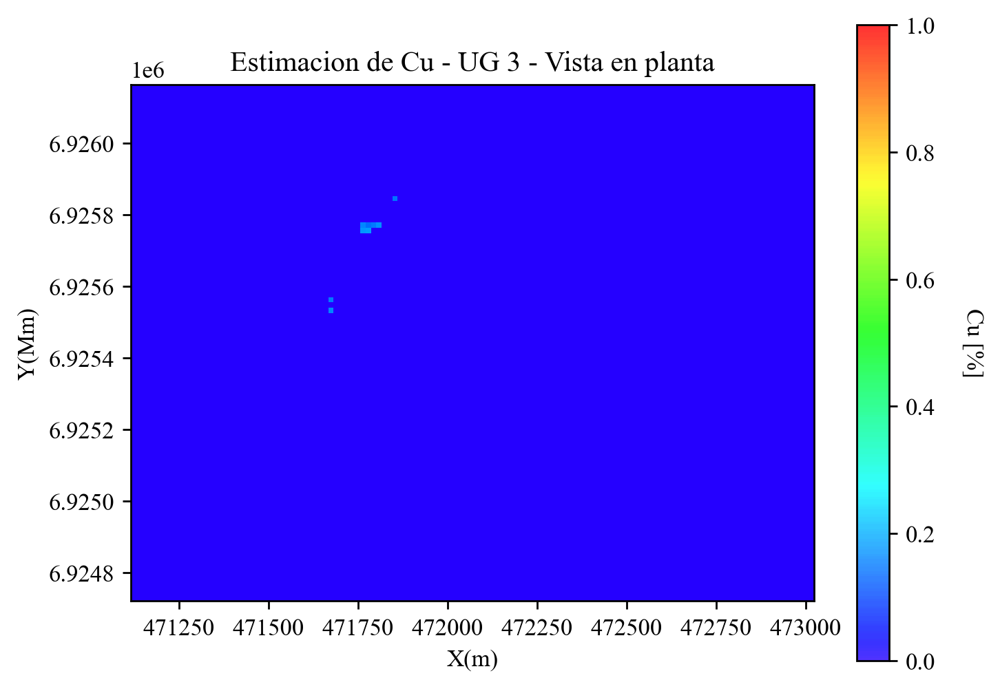

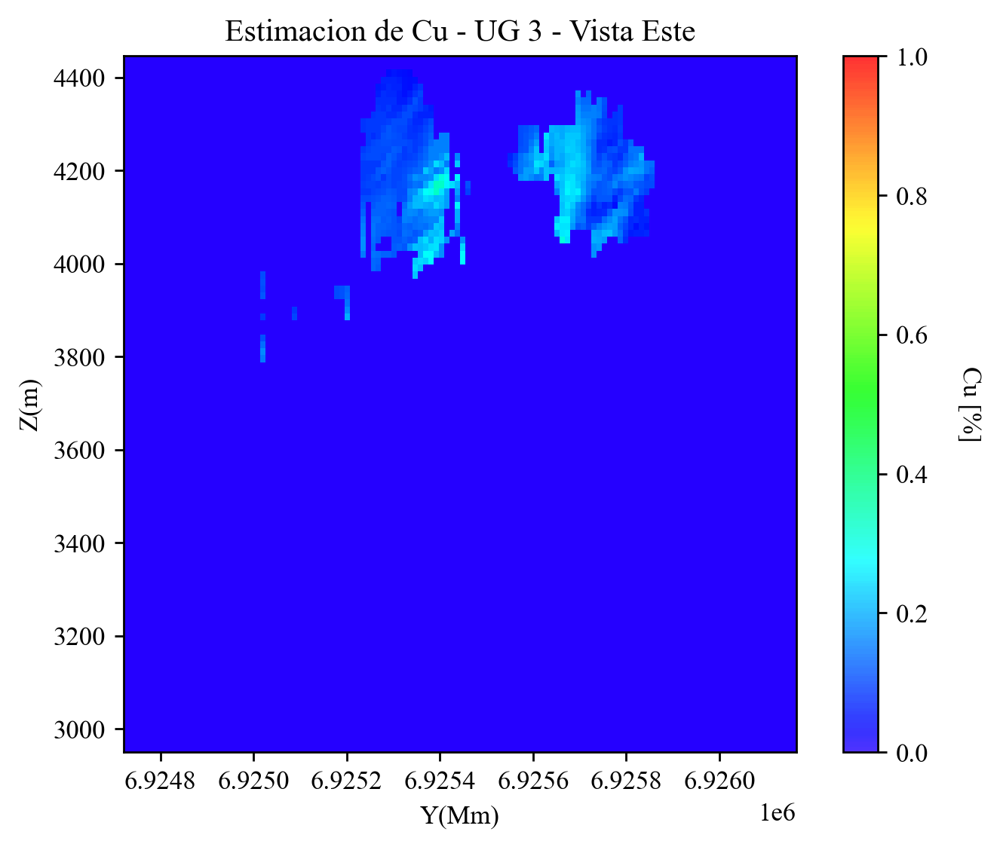

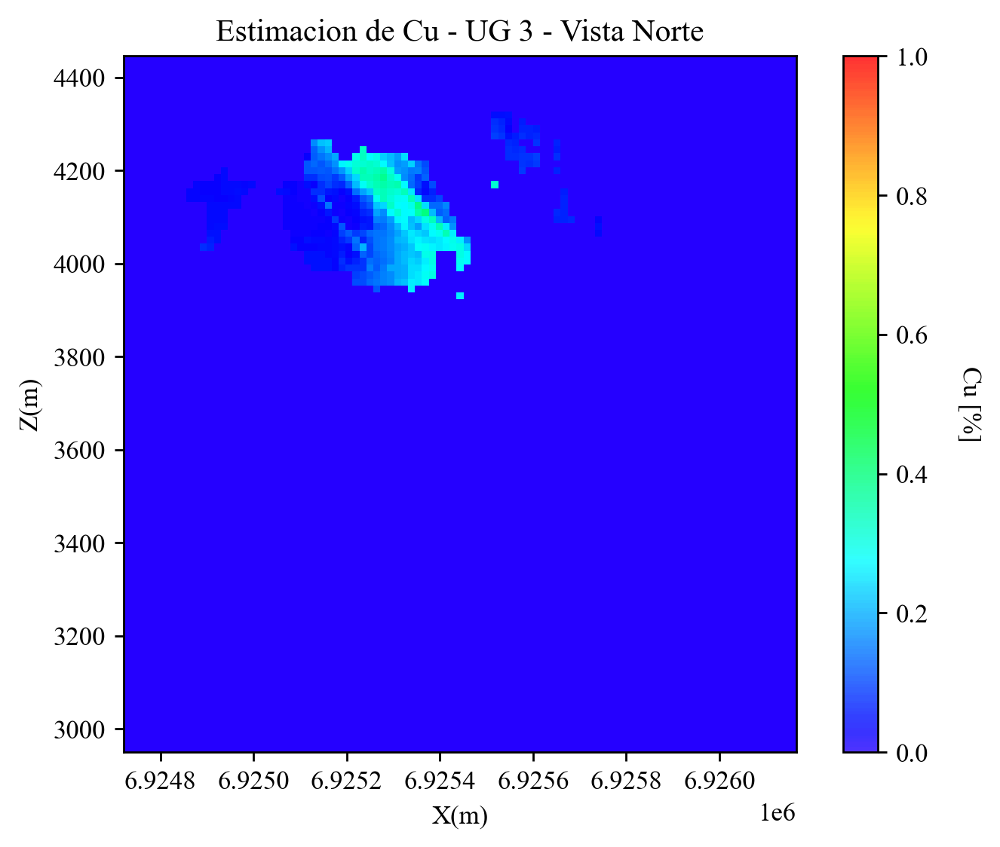

In [67]:
idz = 50; idy = 49; idx = 64   # índices para cortes en z, y, x respectivamente. Valores van entre 0 y nz-1, ny-1, nx-1

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
GSLIB.pixelplt_st(estCU_UG3[idz,:,:],xmin,xmax,ymin,ymax,15,0.0,1.0,'Estimacion de Cu - UG 3 - Vista en planta','X(m)','Y(Mm)','Cu [%]',cmap)

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
GSLIB.pixelplt_st(estCU_UG3[:,idy,:],ymin,ymax,zmin,zmax,15,0.0,1.0,'Estimacion de Cu - UG 3 - Vista Este','Y(Mm)','Z(m)','Cu [%]',cmap)

plt.subplots()
plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
GSLIB.pixelplt_st(estCU_UG3[:,:,idx],ymin,ymax,zmin,zmax,15,0.0,1.0,'Estimacion de Cu - UG 3 - Vista Norte','X(m)','Z(m)','Cu [%]',cmap)



Observamos que la estimación no es realizada en todo el dominio, debido a los radios de búsqueda y las condiciones impuestas en nuestro plan de estimación. Aquellos bloques no estimados se les asigna el valor negativo -99.

Podemos validar nuestra estimación comparando los valores contra las leyes de nuestros sondajes. Estos valores deberían ser similares en aquellos bloques cercanos a las muestras.

### Visualizando nuestro modelo de Leyes

In [68]:
continuous = 'cu_pct'

x_coords = np.linspace(xmin + xsiz/2, xmax - xsiz/2, nx)
y_coords = np.linspace(ymin + ysiz/2, ymax - ysiz/2, ny)
z_coords = np.linspace(zmin + zsiz/2, zmax - zsiz/2, nz)

import plotly.io as pio
# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode
import plotly.graph_objects as go
import plotly.express as px
import plotly.offline as py

fig = go.Figure(data=[go.Scatter3d(
    x=df['X'],
    y=df['Y'],
    z=df['Z'],
    marker=dict(color=df[continuous],
                colorscale=px.colors.sequential.Rainbow[1:],
                cmin=0.0,
                cmax=df[continuous].quantile(0.95),
                size=2.0, # Esta opcion controla el tamaño de los datos
                colorbar=dict(
                    title='Cu [%]',
                    thickness=20,
                    # Add a border to the colorbar
                    outlinecolor='black',  # Color of the border
                    outlinewidth=2,       # Width of the border
                    bordercolor='white',   # Background border color (if applicable)
                    borderwidth=1         # Background border width
                )
                ),
    mode='markers',
    opacity=1
)])

# otras opciones para controlar el color de los elementos de la figura, borrar hovermode para desactivar etiquetas al pasar el mouse
fig.update_layout(    title_text='Estimación de Cu - UG 3',
scene = dict(
                    xaxis = dict(
                        title='Este',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white",),
                    yaxis = dict(
                        title='Norte',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        title='Elevación',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white",),
                    ),
                    font_family="Times New Roman",
                    font_color="black", hovermode=False
                  )

# ocultar la leyenda/autonombre "trace 0" junto al colorbar
fig.update_layout(showlegend=False)

# definir cortes en x, y, z

icz = 60  # índice de corte en z (puede ajustarse), va entre 0 y nz-1

# Agregar cortes del modelo de UGs con la misma escala de colores de plotly
x_slice = np.flip(np.flipud(estCU_UG3[:, :, icx]), axis=1)
y_slice = np.flip(estCU_UG3[:, icy, :], axis=0)
z_slice = np.flip(estCU_UG3[nz-icz, :, :], axis=0)

# X-slice (plano constante x)
YY, ZZ = np.meshgrid(y_coords, z_coords)             # shapes (nz, ny)
XX = np.full_like(YY, x_coords[icx])
surf_x = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=x_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=df[continuous].quantile(0.95),
    showscale=False,
    opacity=1,
    name=f'corte X={x_coords[icx]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Y-slice (plano constante y)
XX, ZZ = np.meshgrid(x_coords, z_coords)             # shapes (nz, nx)
YY = np.full_like(XX, y_coords[icy])
surf_y = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=y_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=df[continuous].quantile(0.95),
    showscale=False,
    opacity=1,
    name=f'corte Y={y_coords[icy]:.1f}',
    hoverinfo='skip',
    hovertemplate=None,
)

# Z-slice (plano constante z)
XX, YY = np.meshgrid(x_coords, y_coords)             # shapes (ny, nx)
ZZ = np.full_like(XX, z_coords[icz])
surf_z = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=z_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=df[continuous].quantile(0.95),
    showscale=False,
    opacity=1,
    name=f'corte Z={z_coords[icz]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Añadir superficies al figure (manteniendo la leyenda y colores consistentes)
fig.add_trace(surf_x)
fig.add_trace(surf_y)
fig.add_trace(surf_z)

fig.show()

## Categorizacion de Recursos - UG 3

La estimación generada anteriormente entrega valores para las leyes de
bloques que tienen distintos niveles de calidad (en cuanto a qué tan acertado
es el valor estimado, si se lo compara con el valor real desconocido). Así, los
bloques estimados en los márgenes del depósito habrán utilizado un número
de muestras menor y la estimación estará por lo tanto sujeta a un error mayor.
Por esta razón, se definen categorías de recursos y reservas.

La categorización de recursos minerales (o geológicos) y reservas mineras es
una de las etapas más críticas en la evaluación de un proyecto minero, dado
que el financiamiento del proyecto y las inversiones dependen de la cantidad
(tonelaje) y calidad (ley) de los recursos y reservas. Además, la decisión de
invertir en el proyecto considera la confiabilidad en los valores estimados de
estos recursos y reservas.

Sin embargo, éste es a la vez uno de los procedimientos más subjetivos en la
evaluación, dado que la clasificación queda sujeta a la opinión experta de un
especialista en evaluación de yacimientos

Haremos nuestra categorizacion de recursos para la UG bajo analisis de acuerdo a la varianza de kriging, el cual es un resultado de utilizar `kt3d`.

In [69]:
## Varianza de la estimación viene en la segunda columna (1)           ↓        del archivo de salida de kt3d
varCU_UG3 = GSLIB.GSLIB2ndarray_3D("./03_resultados/kt3d-bl_UG3.out ", 1, 1, nx, ny, nz)[0][0]

In [70]:
# pio.renderers.default = "colab"
pio.renderers.default = "notebook" # usar esta linea en jupyter notebook o vscode

continuous = 'cu_pct'

var_block_model = varCU_UG3 # setiamos el modelo de varianzas

# encontrar el percentil 99 para definir el rango de colores
max_var = np.nanpercentile(var_block_model, 99.9)

x_coords = np.linspace(xmin + xsiz/2, xmax - xsiz/2, nx)
y_coords = np.linspace(ymin + ysiz/2, ymax - ysiz/2, ny)
z_coords = np.linspace(zmin + zsiz/2, zmax - zsiz/2, nz)


fig = go.Figure(data=[go.Scatter3d(
    x=df['X'],
    y=df['Y'],
    z=df['Z'],
    marker=dict(color=df[continuous]*0.0, # usar un color neutro para los puntos // máxima confianza
                colorscale=px.colors.sequential.Rainbow[1:],
                cmin=0.0,
                cmax=max_var,
                size=2.0, # Esta opcion controla el tamaño de los datos
                colorbar=dict(
                    title='Varianza',
                    thickness=20,
                    # Add a border to the colorbar
                    outlinecolor='black',  # Color of the border
                    outlinewidth=2,       # Width of the border
                    bordercolor='white',   # Background border color (if applicable)
                    borderwidth=1         # Background border width
                )
                ),
    mode='markers',
    opacity=1
)])

# otras opciones para controlar el color de los elementos de la figura, borrar hovermode para desactivar etiquetas al pasar el mouse
fig.update_layout(    title_text='Varianza de estimación de Cu - UG 3',
scene = dict(
                    xaxis = dict(
                        title='Este',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white",),
                    yaxis = dict(
                        title='Norte',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        title='Elevación',
                        backgroundcolor="white",
                        gridcolor="gray",
                        showbackground=True,
                        zerolinecolor="white",),
                    ),
                    font_family="Times New Roman",
                    font_color="black", hovermode=False
                  )

# ocultar la leyenda/autonombre "trace 0" junto al colorbar
fig.update_layout(showlegend=False)

# definir cortes en x, y, z

icz = 60  # índice de corte en z (puede ajustarse), va entre 0 y nz-1

# Agregar cortes del modelo de UGs con la misma escala de colores de plotly
x_slice = np.flip(np.flipud(var_block_model[:, :, icx]), axis=1)
y_slice = np.flip(var_block_model[:, icy, :], axis=0)
z_slice = np.flip(var_block_model[nz-icz, :, :], axis=0)

# X-slice (plano constante x)
YY, ZZ = np.meshgrid(y_coords, z_coords)             # shapes (nz, ny)
XX = np.full_like(YY, x_coords[icx])
surf_x = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=x_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=max_var,
    showscale=False,
    opacity=1,
    name=f'corte X={x_coords[icx]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Y-slice (plano constante y)
XX, ZZ = np.meshgrid(x_coords, z_coords)             # shapes (nz, nx)
YY = np.full_like(XX, y_coords[icy])
surf_y = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=y_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=max_var,
    showscale=False,
    opacity=1,
    name=f'corte Y={y_coords[icy]:.1f}',
    hoverinfo='skip',
    hovertemplate=None,
)

# Z-slice (plano constante z)
XX, YY = np.meshgrid(x_coords, y_coords)             # shapes (ny, nx)
ZZ = np.full_like(XX, z_coords[icz])
surf_z = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=z_slice.astype(float),
    colorscale=px.colors.sequential.Rainbow[1:],
    cmin=0.0,
    cmax=max_var,
    showscale=False,
    opacity=1,
    name=f'corte Z={z_coords[icz]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Añadir superficies al figure (manteniendo la leyenda y colores consistentes)
fig.add_trace(surf_x)
fig.add_trace(surf_y)
fig.add_trace(surf_z)

fig.show()

La varianza de la estimación considera varios aspectos importantes como:

* las características de continuidad espacial de las leyes. Por
ejemplo, muchas mineralizaciones presentan anisotropías, es decir, las
concentraciones del elemento de interés son más continuas en una dirección
que en otras. De hecho, es habitual ver que la variabilidad en la dirección
vertical es diferente a lo que ocurre en el plano horizontal, debido a los
procesos de sedimentación y compactación que ocurren por la gravedad.

* la abundancia y redundancia de
la información a la hora de estimar. La estimación de la ley de un bloque será
tanto mejor, cuanto más informativos sean los datos disponibles. Se puede
tener una situación en que se dispone de la misma cantidad de muestras para
estimar la ley de un bloque, pero éstas poseen configuraciones geométricas
diferentes. A aquel bloque que sea estimado con datos menos redundantes
entre sí, se debe asignarse una mayor confiabilidad.

Nuestro criterio de cateogrizacion sera obtener dos valores de varianza que serviran como limites para clasificar la categoria de los bloques. Obtenemos estas varianzas limite considerando que un:

* Recurso medido es todo aquel cuya varianza de kriging es menor que
aquella de un bloque ubicado al centro de cuatro sondajes ubicados en
una malla cuadrada de 50 por 50 metros.
* Recurso indicado es todo aquel cuya varianza de kriging es mayor que
aquella de un bloque ubicado al centro de cuatro sondajes ubicados en
una malla cuadrada de 50 por 50 metros, pero menor que aquella en el
caso de una malla de 100 por 100 metros.
* Recurso inferido es todo aquel que haya sido estimado de manera
razonable, pero con muy baja confiabilidad. Se asume que existe
continuidad en la mineralización, pero ésta no se comprueba. Una
definición típica de esta clasificación es definir como inferidos sólo
aquellos bloques que se encuentren informados por un número mínimo
de muestras y/o que se encuentren a una distancia mínima de un
sondaje.

Procedemos a descargar estas mallas para calcular estas varianzas en función de nuestro plan de kriging y nuestro modelo variográfico.


### Descargar mallas de sondaje tipo

In [42]:
from urllib.request import urlretrieve
## Descargar archivos a la carpeta 01_data

urls = [
    "https://raw.githubusercontent.com/arqlm/arqlm.github.io/main/courses/MIN431/_static/Sondajes_mi.dat",
    "https://raw.githubusercontent.com/arqlm/arqlm.github.io/main/courses/MIN431/_static/Sondajes_ii.dat",
]

for url in urls:
    filename = url.split("/")[-1]
    try:
        urlretrieve(url, f"./01_data/{filename}")
        print(f"Descargado: {filename}")
    except Exception as e:
        print(f"Error al descargar {filename}: {e}")

Descargado: Sondajes_mi.dat
Descargado: Sondajes_ii.dat


In [72]:
parfile = '''                  Parameters for KT3D
                  *******************

START OF PARAMETERS:
./01_data/Sondajes_mi.dat              -file with data
0  1  2  3  4  0                 -   columns for DH,X,Y,Z,var,sec var
0   1.0e21                 -   trimming limits
0                                -option: 0=grid, 1=cross, 2=jackknife - AR : usamos la opción 1 de cross-validation
xvk.dat                          -file with jackknife data - AR : no se usa en este caso
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var - AR : no se usa en este caso
0                                -debugging level: 0,1,2,3
./03_resultados/kt3d_limite_mi_UG3.dbg                   -file for debugging output
./03_resultados/kt3d_limite_mi_UG3.out                   -file for kriged output
1   0    15			-nx,xmn,xsiz - AR : no se usa en este caso debido a cross-validation
1   0    15			-ny,ymn,ysiz - AR : no se usa en este caso debido a cross-validation
1   0    15			    -nz,zmn,zsiz - AR : no se usa en este caso debido a cross-validation
4    4      2                    -x,y and z block discretization
1    32                           -min, max data for kriging - AR : uso de 8 datos para el krigeo
0                                -max per octant (0-> not used) - AR : 0 si no se desea usar octantes
200.0  200.0  200.0                -maximum search radii - AR : radios de búsqueda de acuerdo a alcances de variograma
 45   60   0.0                 -angles for search ellipsoid - AR : ángulos de búsqueda de acuerdo a azimuts y dips principales del variograma
1     0.37                      -0=SK,1=OK,2=non-st SK,3=exdrift - AR : uso de kriging ordinario, segundo valor no es relevante en este caso
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.dat                     -gridded file with drift/mean
4                                -  column number in gridded file
3 0.003  -nst, nugget effect  - AR: variograma de CU para UG 3  modelado en sección anterior                       
2 0.022 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         200 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 9999 90  -a_hmax, a_hmin, a_vert          
'''

with open("02_parametros/kt3d_limite_mi_UG3.par", "w") as f:
    f.write(parfile)

Ahora ya podemos ejecutar `kt3d` de GSLIB. Puede tardar varios minutos dependiendo del tamaño de la grilla definida.

In [73]:
# Ejecutar kt3d de GSLIB
result = subprocess.run(["./Gslib90/kt3d", "./02_parametros/kt3d_limite_mi_UG3.par"], capture_output=True, text=True, check=True)

Procedemos a leer el valor de varianza limite, que es lo que nos interesa

In [74]:
## Leemos la segunda columna del archivo de salida de kt3d
var_lim_mi_UG3 = []
with open("./03_resultados/kt3d_limite_mi_UG3.out", "r") as f:
    for i, line in enumerate(f):
        if i >= 4:  # Start from the fifth line
            columns = line.split()
            if len(columns) > 1:  # Check if there is a second column
                var_lim_mi_UG3.append(float(columns[1]))

var_lim_mi_UG3

[0.02155885]

Continuamos con el calculo del siguiente limite entre indicados e inferidos.

In [75]:
parfile = '''                  Parameters for KT3D
                  *******************

START OF PARAMETERS:
./01_data/Sondajes_ii.dat              -file with data
0  1  2  3  4  0                 -   columns for DH,X,Y,Z,var,sec var
0   1.0e21                 -   trimming limits
0                                -option: 0=grid, 1=cross, 2=jackknife - AR : usamos la opción 1 de cross-validation
xvk.dat                          -file with jackknife data - AR : no se usa en este caso
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var - AR : no se usa en este caso
0                                -debugging level: 0,1,2,3
./03_resultados/kt3d_limite_ii_UG3.dbg                   -file for debugging output
./03_resultados/kt3d_limite_ii_UG3.out                   -file for kriged output
1   0    15			-nx,xmn,xsiz - AR : no se usa en este caso debido a cross-validation
1   0    15			-ny,ymn,ysiz - AR : no se usa en este caso debido a cross-validation
1   0    15			    -nz,zmn,zsiz - AR : no se usa en este caso debido a cross-validation
4    4      2                    -x,y and z block discretization
1    32                           -min, max data for kriging - AR : uso de 8 datos para el krigeo
0                                -max per octant (0-> not used) - AR : 0 si no se desea usar octantes
200.0  200.0  200.0                -maximum search radii - AR : radios de búsqueda de acuerdo a alcances de variograma
 45   60   0.0                 -angles for search ellipsoid - AR : ángulos de búsqueda de acuerdo a azimuts y dips principales del variograma
1     0.37                      -0=SK,1=OK,2=non-st SK,3=exdrift - AR : uso de kriging ordinario, segundo valor no es relevante en este caso
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.dat                     -gridded file with drift/mean
4                                -  column number in gridded file
3 0.003  -nst, nugget effect  - AR: variograma de CU para UG 3  modelado en sección anterior                       
2 0.022 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         200 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 100 90  -a_hmax, a_hmin, a_vert                    
2 0.005 45 60  0.0    -it,cc,ang1,ang2,ang3                       
         9999 9999 90  -a_hmax, a_hmin, a_vert          
'''

with open("02_parametros/kt3d_limite_ii_UG3.par", "w") as f:
    f.write(parfile)

Ahora ya podemos ejecutar `kt3d` de GSLIB. Puede tardar varios minutos dependiendo del tamaño de la grilla definida.

In [76]:
# Ejecutar kt3d de GSLIB
result = subprocess.run(["./Gslib90/kt3d", "./02_parametros/kt3d_limite_ii_UG3.par"], capture_output=True, text=True, check=True)

Procedemos a leer el valor de varianza limite, que es lo que nos interesa.

In [77]:
## Leemos la segunda columna del archivo de salida de kt3d
var_lim_ii_UG3 = []
with open("./03_resultados/kt3d_limite_ii_UG3.out", "r") as f:
    for i, line in enumerate(f):
        if i >= 4:  # Start from the fifth line
            columns = line.split()
            if len(columns) > 1:  # Check if there is a second column
                var_lim_ii_UG3.append(float(columns[1]))

var_lim_ii_UG3

[0.02679717]

Con esta información, creamos un modelo de bloques de categorías, y clasificamos los bloques de acuerdo a las distintas varianzas de kriging.

In [78]:
## Transformamos la varianza del modelo de bloques varCU_UG3 en una variable que indique la categoría del bloque usando numpy

categoria_UG3 = np.empty(varCU_UG3.flatten().shape, dtype=object)
categoria_UG3[:] = "Sin Categoría"  # Valor por defecto para bloques sin datos
categoria_UG3[(varCU_UG3.flatten() < var_lim_mi_UG3) & (varCU_UG3.flatten() >= 0)] = "Medido"  # Categoría 1: Varianza baja
categoria_UG3[varCU_UG3.flatten() >= var_lim_ii_UG3] = "Inferido"  # Categoría 3: Varianza alta
categoria_UG3[(varCU_UG3.flatten() < var_lim_ii_UG3) & (varCU_UG3.flatten() >= var_lim_mi_UG3)] = "Indicado"  # Categoría 2: Varianza media
categoria_UG3 = np.array(categoria_UG3).reshape(varCU_UG3.shape)

Ya podemos visualizar los distintos resultados de nuestra categorización.

Podemos ver las proporciones de cada categoría.

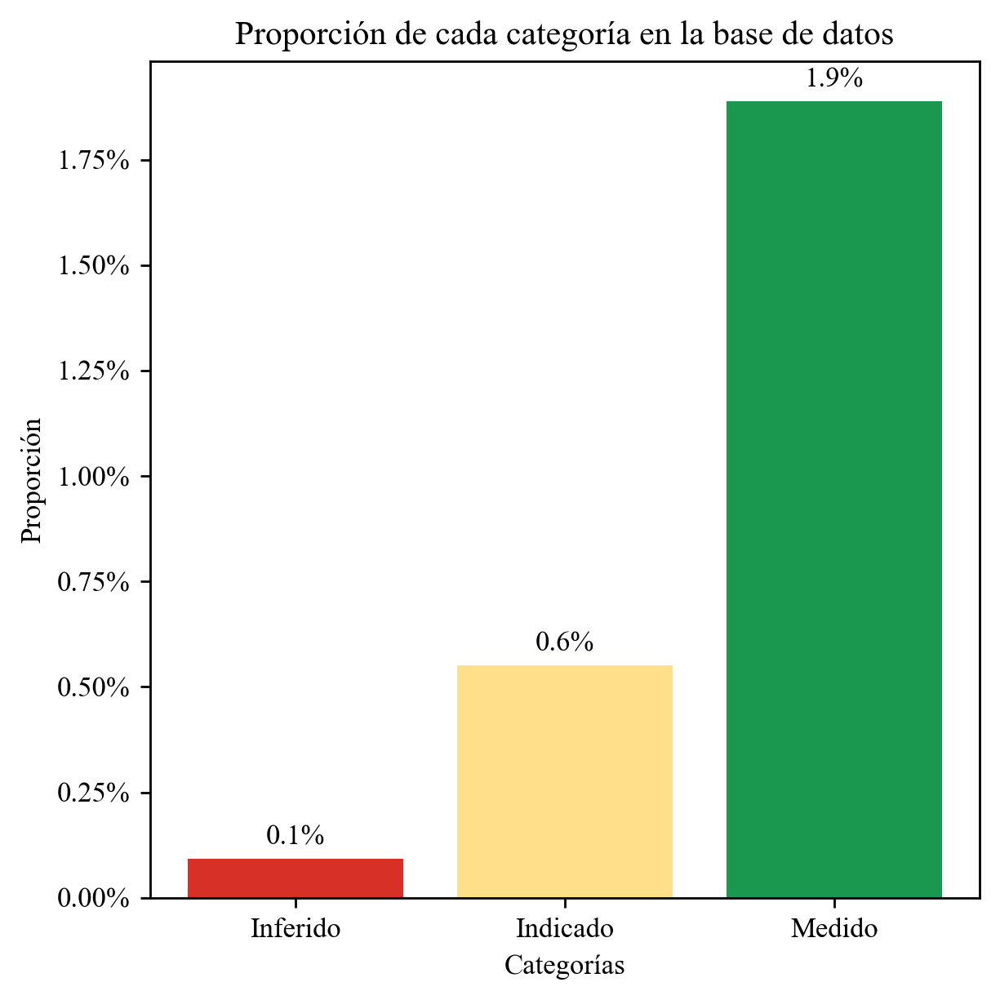

In [79]:
fig, ax = plt.subplots(figsize=(5,5))
ax.clear()

plt.rcParams['figure.dpi'] = 250 # Setear resolución de la figura
plt.rcParams["font.family"] = "Times New Roman"

# Proporciones de cada categoría en nuestra base de datos ordenados por Inferido, Indicado, Medido
color = ['#d73027', '#fee08b', '#1a9850']   # Colores para Inferido, Indicado, Medido

proportions = pd.Series(categoria_UG3.flatten()).value_counts(normalize=True).sort_index()
labels = proportions.index.tolist()

# barras ordenadas por Inferido, Indicado, Medido
ordered_labels = ['Inferido', 'Indicado', 'Medido']
proportions = proportions.reindex(ordered_labels)

bars = ax.bar(proportions.index, proportions.values, color=color)

ax.set_title('Proporción de cada categoría en la base de datos')
ax.set_xlabel('Categorías')
ax.set_ylabel('Proporción')
ax.yaxis.set_major_formatter(mticker.PercentFormatter(1.0))

for bar, p in zip(bars, proportions.values):
    ax.annotate(f"{p*100:.1f}%", xy=(bar.get_x() + bar.get_width() / 2, p),
                xytext=(0, 3), textcoords="offset points", ha='center', va='bottom')

fig.tight_layout()
plt.show()

Asi como visualizar algunas secciones en tres dimensiones. Mientras mas lejos de un sondaje, menor categoría.

In [80]:
# Ensure renderer is appropriate for your environment (notebook / vscode)
pio.renderers.default = 'notebook'

# --- Input assumptions (these must exist in the environment) ---
# df: pandas DataFrame with columns 'X','Y','Z'
# categoria_UG3: numpy array with shape (nz, ny, nx) containing strings: 'Inferido','Indicado','Medido'
# x_coords, y_coords, z_coords: 1D coordinate arrays for grid cell centers (lengths nx, ny, nz)
# icx, icy, icz: integer indices for the central slices to display
# nz, ny, nx: grid dimensions

# Map categories to numeric codes
cat_to_num = {'Inferido': 0, 'Indicado': 1, 'Medido': 2}
cat_num = np.vectorize(lambda x: cat_to_num.get(x, np.nan))(categoria_UG3)
cat_num = cat_num.astype(float)  # allow NaNs

# Create slices (same convention used in the notebook)
x_slice = np.flip(np.flipud(cat_num[:, :, icx]), axis=1)   # X-slice (nz, ny)
y_slice = np.flip(cat_num[:, icy, :], axis=0)             # Y-slice (nz, nx)
z_slice = np.flip(cat_num[nz-icz, :, :], axis=0)          # Z-slice (ny, nx)

# Discrete colors: Inferido (red), Indicado (yellow), Medido (green)
# We use normalized stops [0.0, 0.5, 1.0] so numeric codes 0,1,2 map exactly to the three colors
colorscale = [
    [0.0, '#d73027'],   # Inferido -> 0
    [0.5, "#fff700"],   # Indicado -> 1 (normalized to 0.5)
    [1.0, '#1a9850']    # Medido -> 2 (normalized to 1.0)
]

# Build surface for X-slice
YY, ZZ = np.meshgrid(y_coords, z_coords)             # shapes (nz, ny)
XX = np.full_like(YY, x_coords[icx])
surf_x = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=x_slice.astype(float),
    colorscale=colorscale,
    cmin=0, cmax=2,
    showscale=False,
    opacity=1,
    name=f'corte X={x_coords[icx]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Build surface for Y-slice
XX, ZZ = np.meshgrid(x_coords, z_coords)             # shapes (nz, nx)
YY = np.full_like(XX, y_coords[icy])
surf_y = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=y_slice.astype(float),
    colorscale=colorscale,
    cmin=0, cmax=2,
    showscale=False,
    opacity=1,
    name=f'corte Y={y_coords[icy]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Build surface for Z-slice (we enable a colorbar here with categorical ticks)
XX, YY = np.meshgrid(x_coords, y_coords)             # shapes (ny, nx)
ZZ = np.full_like(XX, z_coords[icz])
surf_z = go.Surface(
    x=XX, y=YY, z=ZZ,
    surfacecolor=z_slice.astype(float),
    colorscale=colorscale,
    cmin=0, cmax=2,
    showscale=True,
    colorbar=dict(
        title='Categoría',
        tickvals=[0, 1, 2],
        ticktext=['Inferido', 'Indicado', 'Medido'],
        thickness=20
    ),
    opacity=1,
    name=f'corte Z={z_coords[icz]:.1f}',
    hoverinfo='skip',
    hovertemplate=None
)

# Add sample points as neutral black markers for reference
scatter_samples = go.Scatter3d(
    x=df['X'], y=df['Y'], z=df['Z'],
    mode='markers',
    marker=dict(color='black', size=2, opacity=0.8),
    name='Muestras'
)

# Compose figure
fig = go.Figure(data=[scatter_samples, surf_x, surf_y, surf_z])
fig.update_layout(
    title='Categoría UG3 (Inferido=rojo, Indicado=amarillo, Medido=verde)',
    scene=dict(
        xaxis=dict(title='Este'),
        yaxis=dict(title='Norte'),
        zaxis=dict(title='Elevación')
    ),
    width=900,
    height=720,
    font=dict(family='Times New Roman', size=12)
)

fig.show()

## Exportar modelo

Una vez verificado que las muestras iniciales coinciden hacen sentido con el modelo de unidades geológicas, podemos exportar los modelos de bloques tanto de leyes como de categorías, los cuales **serán utilizados nuevamente una vez finalizada la estimación de leyes dentro para cada unidad**, de forma de compilar un modelo de final de leyes y categorías.

In [ ]:
## Exportar modelo de leyes en formato GSLIB
GSLIB.ndarray2GSLIB_3D(estCU_UG3,'./03_resultados/modelo_leyes_UG3.dat', 'cu_pct')

## Exportar categorias en formato GSLIB
GSLIB.ndarray2GSLIB_3D(categoria_UG3,'./03_resultados/modelo_categorias_UG3.dat', 'categoria')